In [1]:
cd D:\chai_WJH\Neomycin_Project\R

D:\chai_WJH\Neomycin_Project\R


In [2]:
pip list

Package                   VersionNote: you may need to restart the kernel to use updated packages.

------------------------- ------------
aiohttp                   3.9.3
aiosignal                 1.3.1
anaconda                  0.0.1.1
anndata                   0.9.2
anyio                     4.2.0
arboreto                  0.1.6
argon2-cffi               21.3.0
argon2-cffi-bindings      21.2.0
asttokens                 2.0.5
async-lru                 2.0.4
async-timeout             4.0.3
attrs                     23.1.0
Babel                     2.11.0
backcall                  0.2.0
beautifulsoup4            4.12.2
bleach                    4.1.0
bokeh                     3.1.1
boltons                   23.1.1
Brotli                    1.0.9
certifi                   2024.2.2
cffi                      1.16.0
charset-normalizer        2.0.4
click                     8.1.7
cloudpickle               3.0.0
colorama                  0.4.6
comm                      0.1.2
contourpy        

In [3]:
import scanpy as sc
sc.set_figure_params()
adata1 = sc.read_10x_mtx('./P3_NEO/filtered_feature_bc_matrix')
print(adata1)

AnnData object with n_obs × n_vars = 11773 × 33696
    var: 'gene_ids', 'feature_types'


In [4]:
import scanpy as sc
sc.set_figure_params()
adata2 = sc.read_10x_mtx('./P3_CTR/filtered_feature_bc_matrix')
print(adata2)

AnnData object with n_obs × n_vars = 18264 × 33696
    var: 'gene_ids', 'feature_types'


In [5]:
adata1=sc.AnnData(adata1.X,obs=adata1.obs,var=adata1.var)
adata1.var["Gene"]=adata1.var_names
adata1.obs["CellID"]=adata1.obs_names

In [6]:
adata1

AnnData object with n_obs × n_vars = 11773 × 33696
    obs: 'CellID'
    var: 'gene_ids', 'feature_types', 'Gene'

In [7]:
adata2=sc.AnnData(adata2.X,obs=adata2.obs,var=adata2.var)
adata2.var["Gene"]=adata2.var_names
adata2.obs["CellID"]=adata2.obs_names

In [8]:
adata2

AnnData object with n_obs × n_vars = 18264 × 33696
    obs: 'CellID'
    var: 'gene_ids', 'feature_types', 'Gene'

In [9]:
adata1.obs['batch']='NEO'
adata2.obs['batch']='CTR'

In [10]:
adata1.var['mt'] = adata1.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

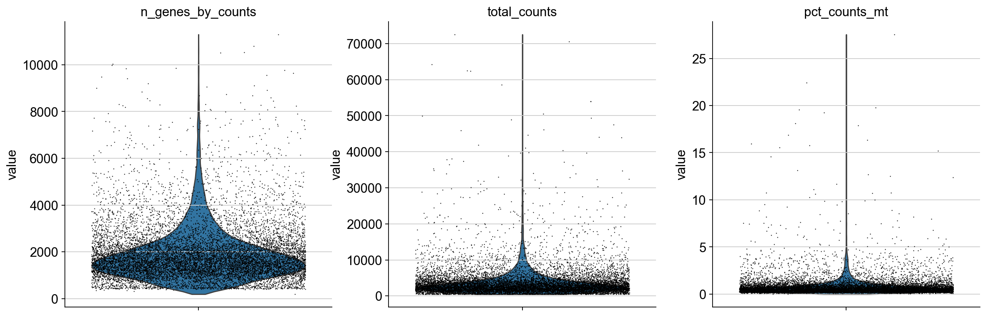

In [11]:
sc.pl.violin(adata1, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

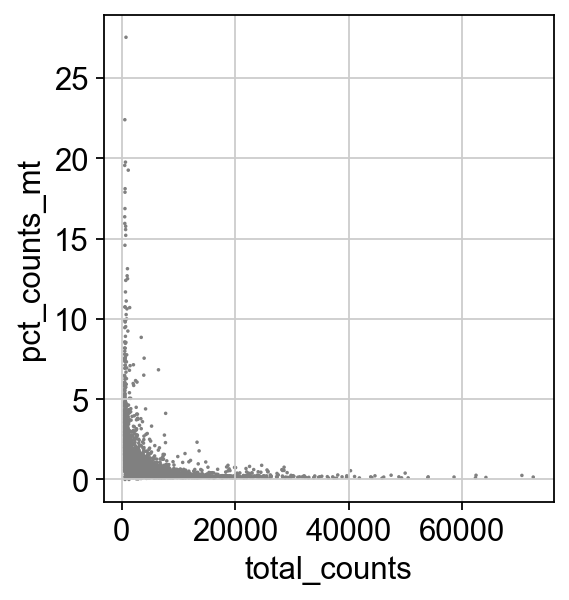

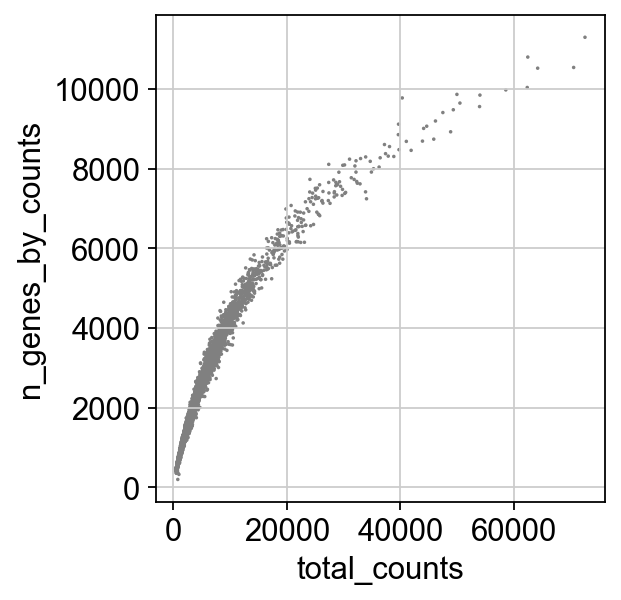

In [12]:
sc.pl.scatter(adata1, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata1, x='total_counts', y='n_genes_by_counts')

<Axes: xlabel='total_counts', ylabel='n_genes_by_counts'>

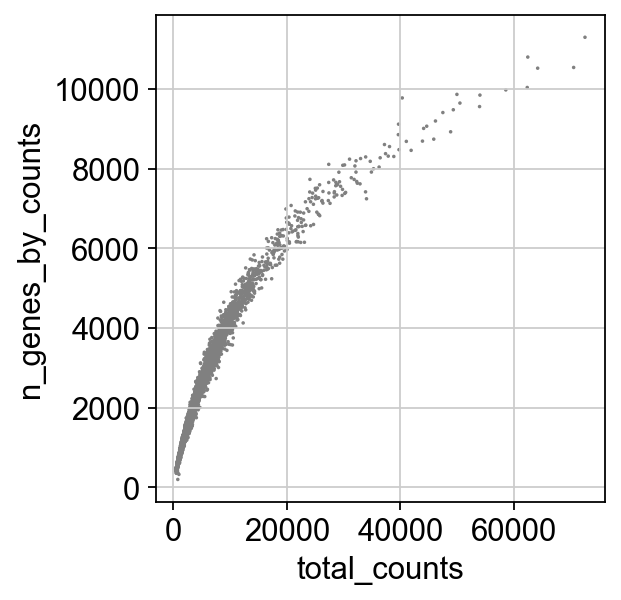

In [13]:
n_genes_filter = 5000
n_counts_filter = 500
sc.pl.scatter(adata1, x='total_counts', y='n_genes_by_counts', show = False)

In [14]:
adata1 = adata1[adata1.obs.n_genes_by_counts < 5000, :]
adata1 = adata1[adata1.obs.total_counts > 500, :]
adata1 = adata1[adata1.obs.pct_counts_mt < 25, :]
adata1

View of AnnData object with n_obs × n_vars = 11457 × 33696
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

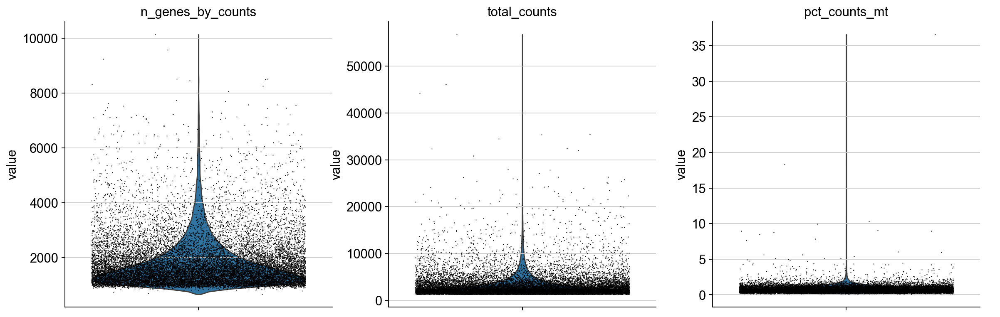

In [15]:
adata2.var['mt'] = adata2.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata2, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata2, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

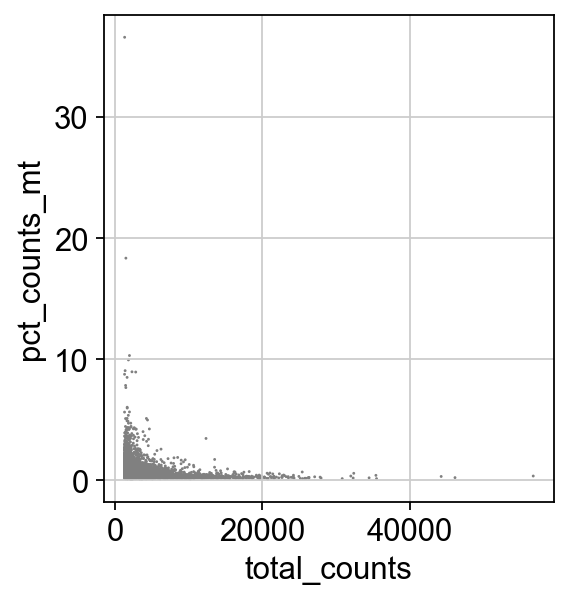

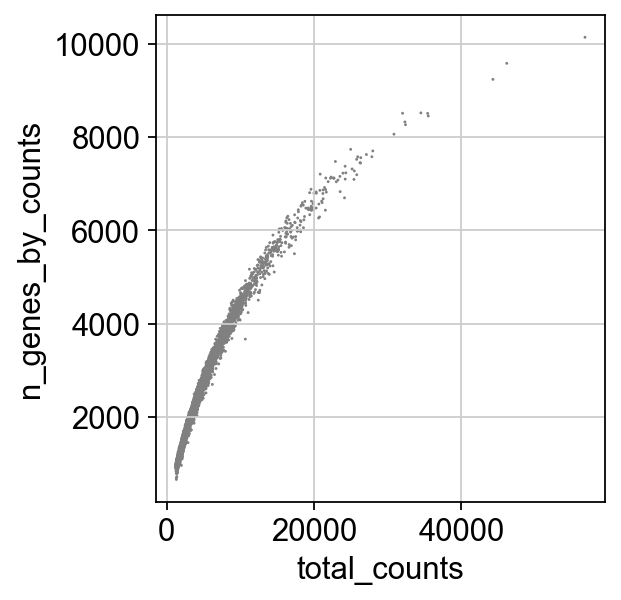

In [16]:
sc.pl.scatter(adata2, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata2, x='total_counts', y='n_genes_by_counts')

In [17]:
adata2 = adata2[adata2.obs.n_genes_by_counts < 5000, :]
adata2 = adata2[adata2.obs.total_counts > 500, :]
adata2 = adata2[adata2.obs.pct_counts_mt < 25, :]
adata2

View of AnnData object with n_obs × n_vars = 17995 × 33696
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [18]:
adata1=adata1.copy()
adata1.layers["counts"] =adata1.X.copy()
adata1

AnnData object with n_obs × n_vars = 11457 × 33696
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts'

In [19]:
adata2=adata2.copy()
adata2.layers["counts"] =adata2.X.copy()
adata2

AnnData object with n_obs × n_vars = 17995 × 33696
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    layers: 'counts'

In [20]:
adata1.raw = adata1
adata2.raw = adata2

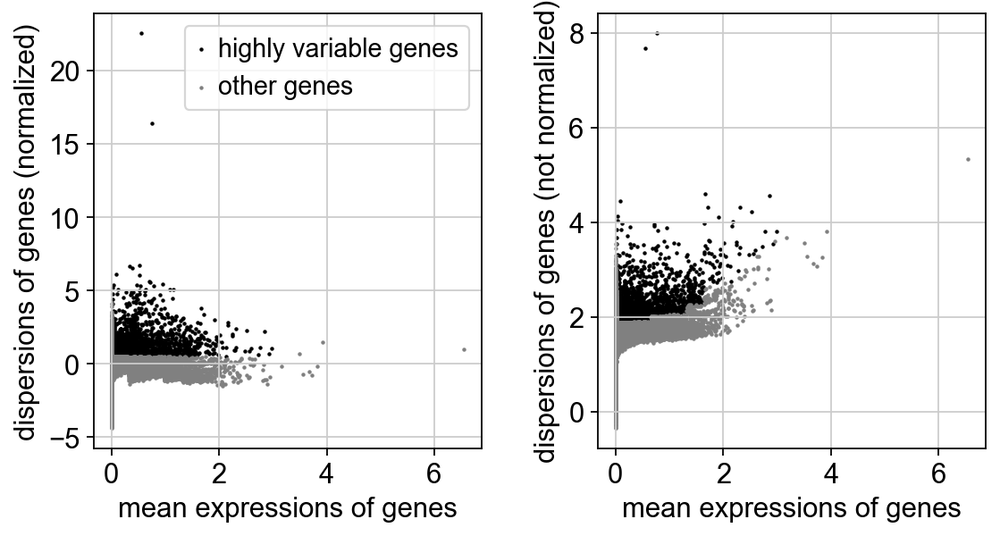

In [21]:
sc.pp.normalize_total(adata1, target_sum=1e4)
sc.pp.log1p(adata1)
sc.pp.highly_variable_genes(adata1, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata1)

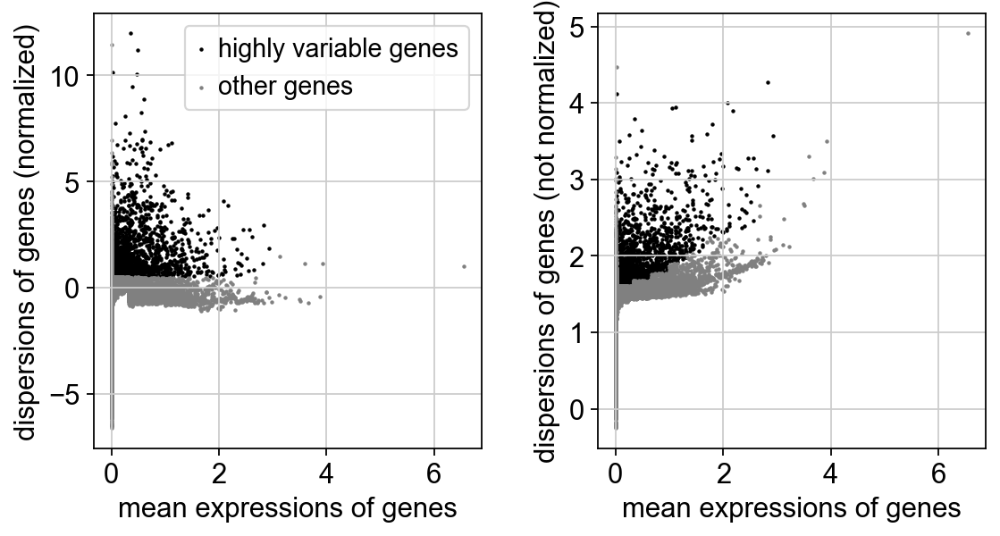

In [22]:
sc.pp.normalize_total(adata2, target_sum=1e4)
sc.pp.log1p(adata2)
sc.pp.highly_variable_genes(adata2, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata2)

In [23]:
adata1 = adata1[:, adata1.var.highly_variable]
adata2 = adata2[:, adata2.var.highly_variable]

In [24]:
adata1

View of AnnData object with n_obs × n_vars = 11457 × 3796
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts'

In [25]:
adata2

View of AnnData object with n_obs × n_vars = 17995 × 2428
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts'

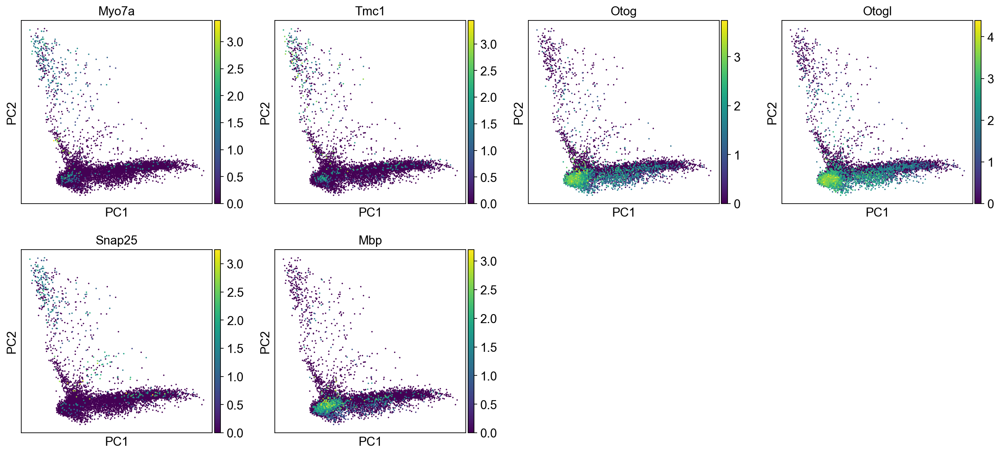

In [26]:
sc.pp.regress_out(adata1, ['total_counts'])
sc.pp.scale(adata1, max_value=10)
sc.tl.pca(adata1, svd_solver='arpack',n_comps=100)
sc.pl.pca(adata1, color=['Myo7a','Tmc1','Otog','Otogl','Snap25','Mbp' ] )

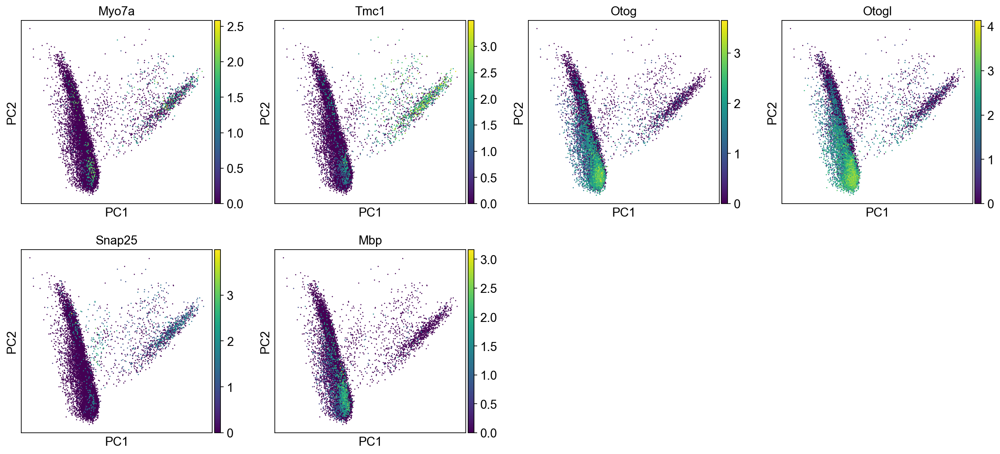

In [27]:
sc.pp.regress_out(adata2, ['total_counts'])
sc.pp.scale(adata2, max_value=10)
sc.tl.pca(adata2, svd_solver='arpack',n_comps=100)
sc.pl.pca(adata2, color=['Myo7a','Tmc1','Otog','Otogl','Snap25','Mbp' ] )

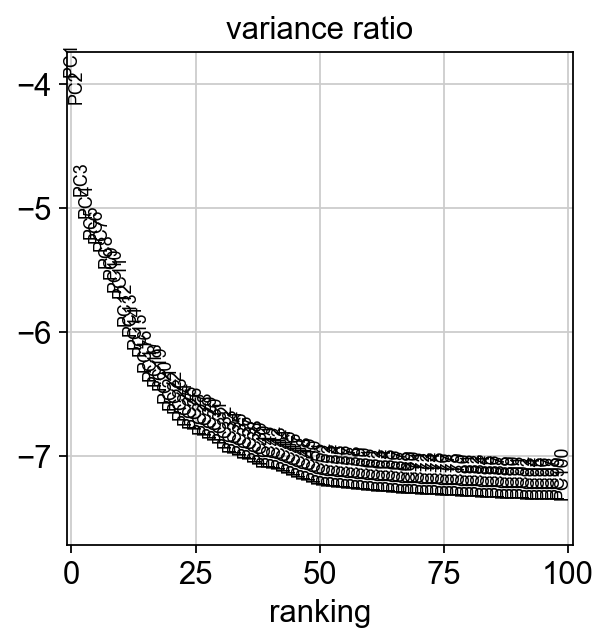

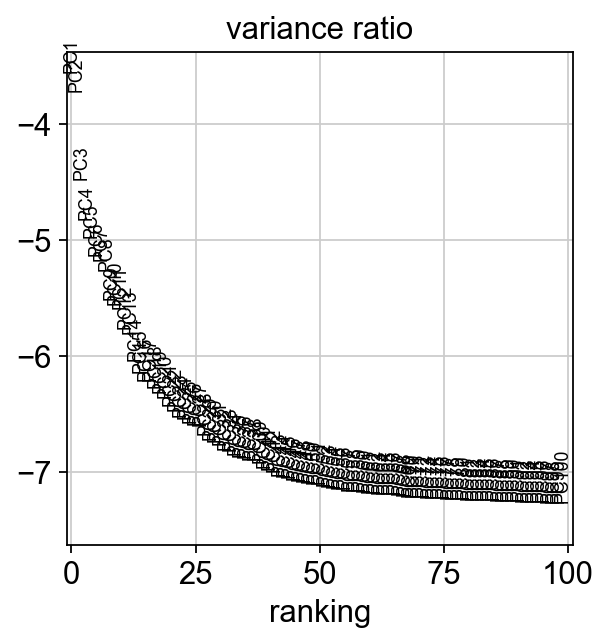

In [28]:
sc.pl.pca_variance_ratio(adata1, log=True,n_pcs=100)
sc.pl.pca_variance_ratio(adata2, log=True,n_pcs=100)

In [29]:
adata1.write("P3_NEO_SCANPY.h5ad")

In [30]:
adata2.write("P3_CTR_SCANPY.h5ad")

In [31]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import sys
import scipy
import anndata


plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams["font.family"] = "Arial"

sc.set_figure_params(figsize=(4, 4))
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 600, vector_friendly = True, format = 'pdf')
palette = ['#fbbc04', '#199de5', '#cfe6d5']

In [32]:
def Barplot(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
#     ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
#                        dpi=300, orientation='landscape', format= 'pdf', optimize=True)

In [33]:
data_dir = '/chai_WJH/Neomycin_Project/R/'

In [34]:
adata1 = sc.read(data_dir + 'P3_NEO_SCANPY.h5ad')

In [35]:
adata2 = sc.read(data_dir + 'P3_CTR_SCANPY.h5ad')

In [36]:
adata1

AnnData object with n_obs × n_vars = 11457 × 3796
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [37]:
adata2

AnnData object with n_obs × n_vars = 17995 × 2428
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [38]:
sc.pp.neighbors(adata1, n_neighbors=30, n_pcs=100)
sc.tl.leiden(adata1,resolution=2)
sc.tl.louvain(adata1)
sc.tl.umap(adata1)

In [39]:
sc.pp.neighbors(adata2, n_neighbors=30, n_pcs=100)
sc.tl.leiden(adata2,resolution=2)
sc.tl.louvain(adata2)
sc.tl.umap(adata2)

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


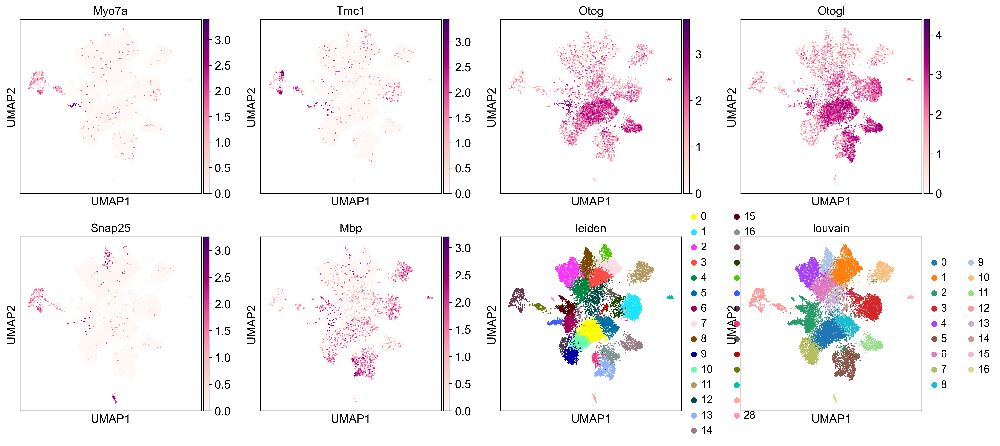

In [40]:
sc.pl.umap(adata1, color=['Myo7a','Tmc1','Otog','Otogl','Snap25','Mbp','leiden','louvain'])

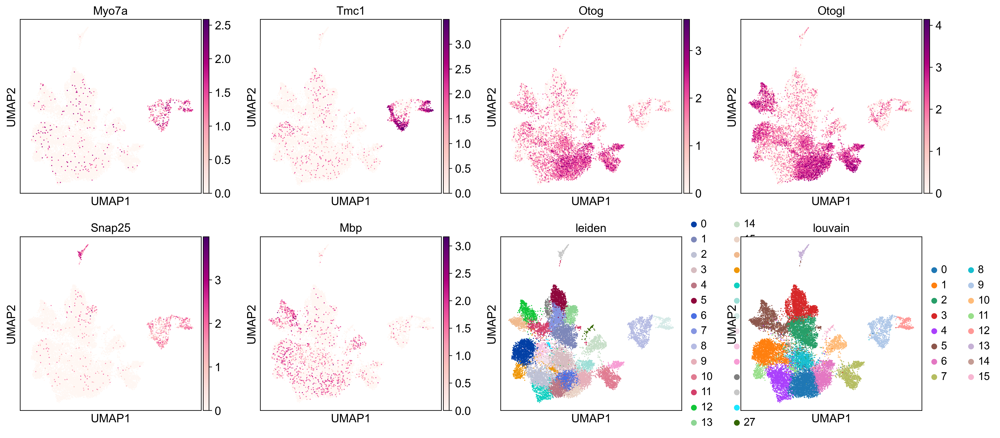

In [41]:
sc.pl.umap(adata2, color=['Myo7a','Tmc1','Otog','Otogl','Snap25','Mbp','leiden','louvain'])

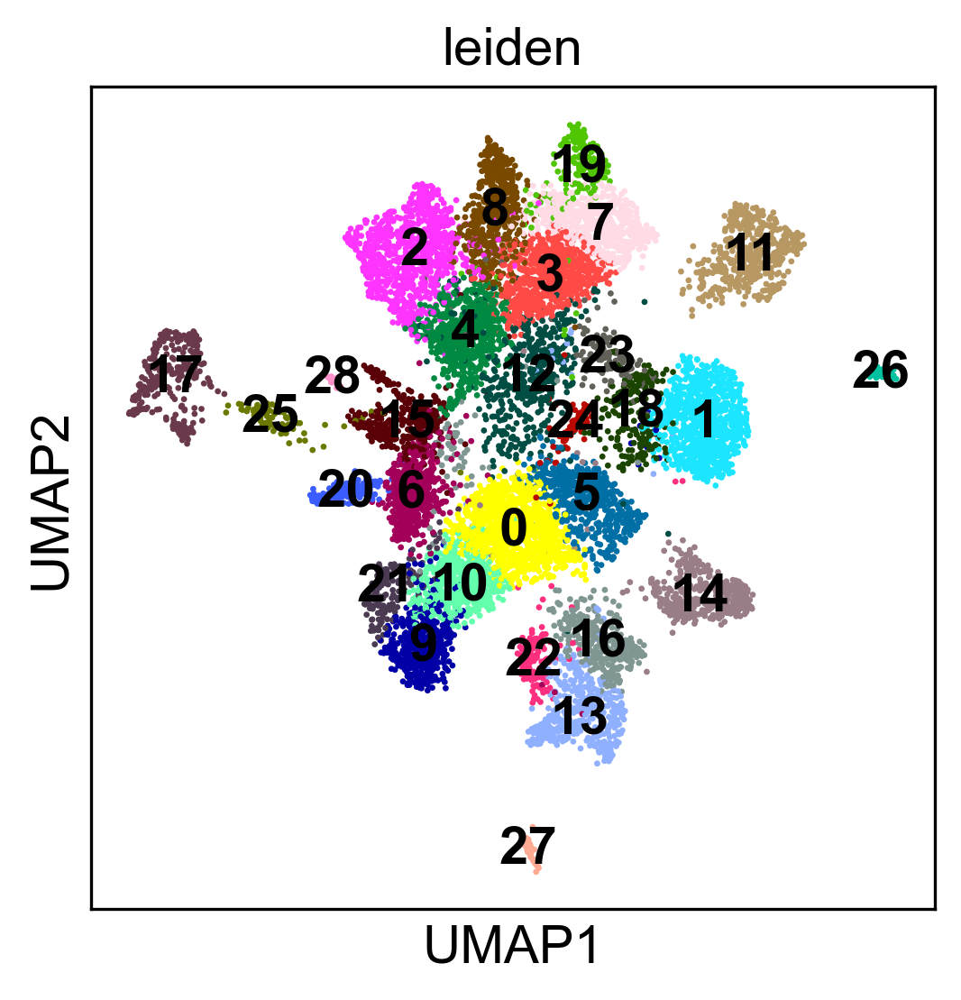

In [42]:
sc.pl.umap(adata1, color=['leiden'],legend_loc="on data")

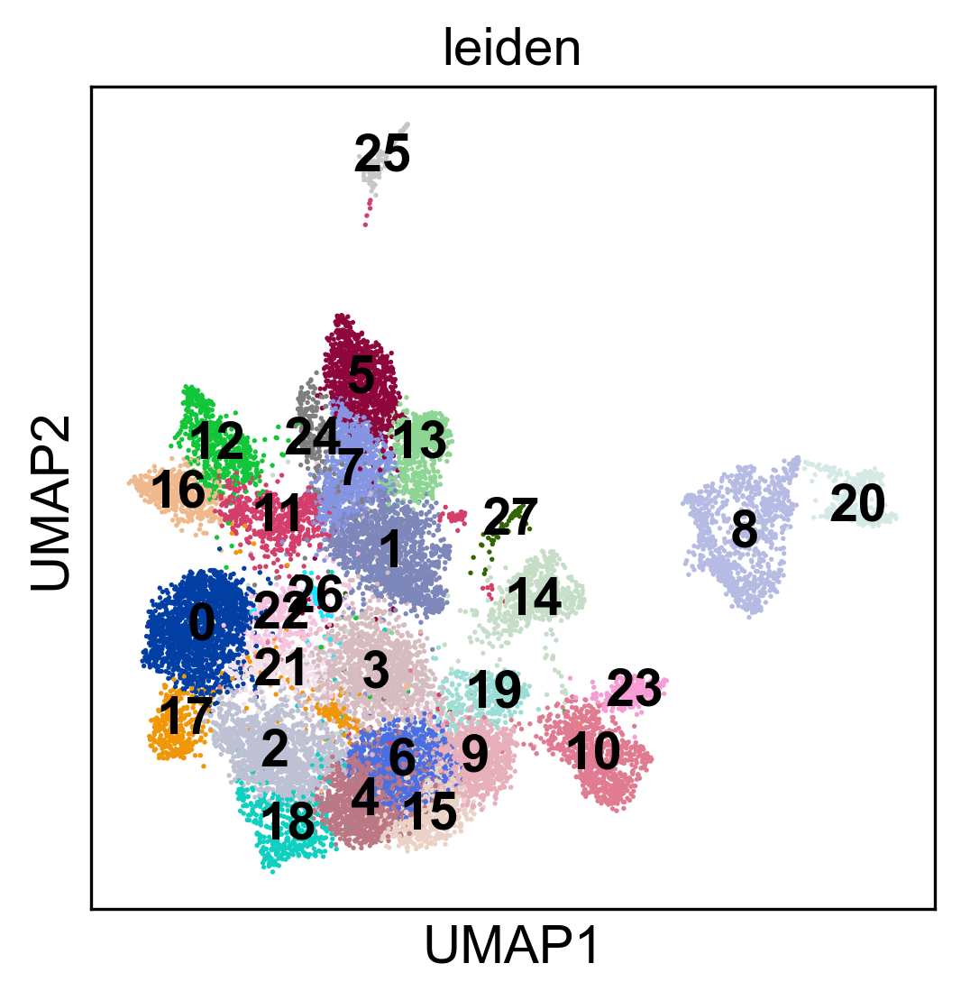

In [43]:
sc.pl.umap(adata2, color=['leiden'],legend_loc="on data")

In [44]:
marker_genes = [
    *["Tmc1","Slc26a5","Strip2","Pou4f3","Lmo7","Otof","Slc17a8"],#HAIR CELLS
    *["Anxa5","Fabp7","Gjb2","Matn4","Prss23"],#IPh_IBC
    *["Egfl6","Fst","Nupr1","Pmch"],#HeC
    *["Cryab","Emid1","Igfbpl1","Npy","S100b","Serpine2","Smagp","Hes5","Pdzk1ip1","Ppp1r2","Lfng","S100a1","Prss23"],#PILLAR CELLS, DEITERS' CELLS
    *["Dcn","Ddost","Rcn3","Sdf2l1",
      "Cpxm2","Fkbp9","Kazald1","Tectb",
      "Cst3","Gjb6","Net1","Tsen15",
      "Calb1","Crabp1","Epyc","Itm2a"],#KO
    *["Ptgds","Smoc2","Otoa","Fxyd6","Cdkn1c"],#IdC
    *["Emilin2","Slc1a3","Axin2","Tjp1","Atp1a2","Emcn","Coch","Otor"], #TYMPANIC BORDER CELLS
    
    *["Snap25","Nefl","Pvalb","Tubb3","Th","Ano2","Prph"],#SGN
    *["Slc4a4","Gpc6","Vmo1","Enah","Krt8","Krt18","Slc26a7"], #RMC
]

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


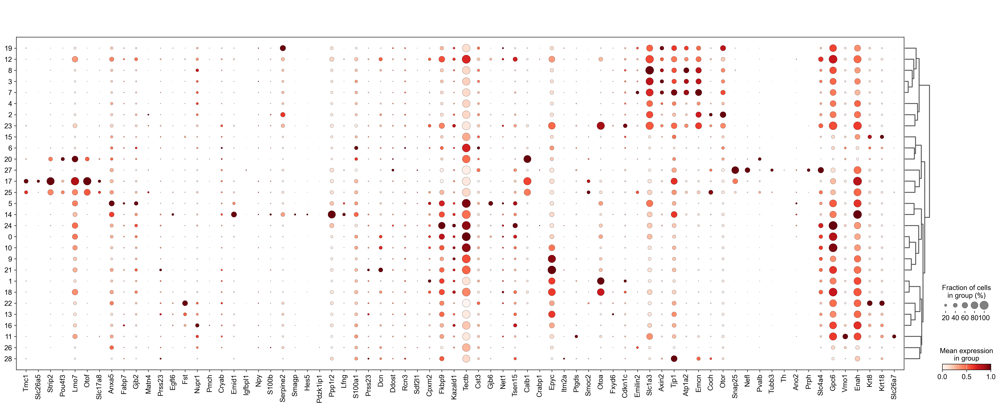

In [45]:
sc.tl.dendrogram(adata1,groupby='leiden')
sc.pl.dotplot(adata1, marker_genes, groupby="leiden",dendrogram=True, standard_scale="var");

In [46]:
small_marker_dict={
     'HC' :["Tmc1","Slc26a5","Strip2","Pou4f3","Lmo7","Otof","Slc17a8"],
    'IPh_IBC':["Anxa5","Fabp7","Gjb2","Matn4","Prss23"],
    'HeC':["Egfl6","Fst","Nupr1","Pmch"],
    'PC_DC':["Cryab","Emid1","Igfbpl1","Npy","S100b","Serpine2","Smagp","Hes5","Pdzk1ip1","Ppp1r2","Lfng","S100a1","Prss23"],
     'KO':["Dcn","Ddost","Rcn3","Sdf2l1",
      "Cpxm2","Fkbp9","Kazald1","Tectb",
      "Cst3","Gjb6","Net1","Tsen15",
      "Calb1","Crabp1","Epyc","Itm2a"],
'IdC':["Ptgds","Smoc2","Otoa","Fxyd6","Cdkn1c"],
     'TBC':["Emilin2","Slc1a3","Axin2","Tjp1","Atp1a2","Emcn","Coch","Otor"],
    'SGN':["Snap25","Nefl","Pvalb","Tubb3","Th","Ano2","Prph"],
     'RMC':["Slc4a4","Gpc6","Vmo1","Enah","Krt8","Krt18","Slc26a7"],
}
# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in adata1.var.index:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

In [47]:
smarker_genes_in_data

{'HC': ['Tmc1', 'Strip2', 'Pou4f3', 'Lmo7', 'Otof', 'Slc17a8'],
 'IPh_IBC': ['Fabp7', 'Gjb2', 'Prss23'],
 'HeC': ['Egfl6', 'Fst', 'Nupr1', 'Pmch'],
 'PC_DC': ['Cryab', 'Npy', 'S100b', 'Serpine2', 'Smagp', 'S100a1', 'Prss23'],
 'KO': ['Dcn',
  'Ddost',
  'Rcn3',
  'Sdf2l1',
  'Cst3',
  'Calb1',
  'Crabp1',
  'Epyc',
  'Itm2a'],
 'IdC': ['Ptgds', 'Smoc2', 'Otoa', 'Fxyd6', 'Cdkn1c'],
 'TBC': ['Emilin2', 'Slc1a3', 'Axin2', 'Atp1a2', 'Emcn', 'Coch', 'Otor'],
 'SGN': ['Snap25', 'Nefl', 'Pvalb'],
 'RMC': ['Vmo1', 'Krt8', 'Krt18', 'Slc26a7']}

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


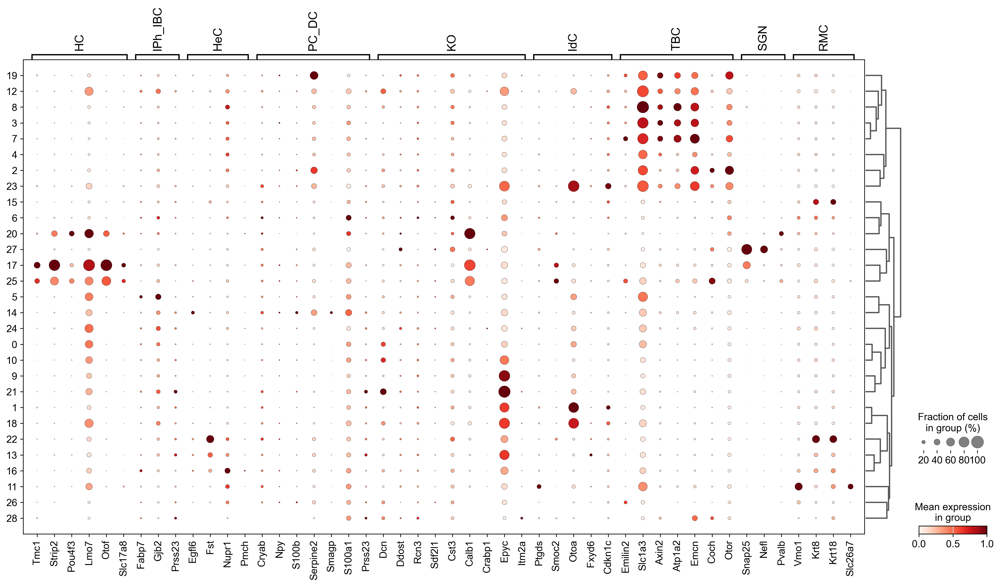

In [48]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata1,
    groupby="leiden",
    var_names=smarker_genes_in_data,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     save="cochlea-cell_type_p3_neo_dotplot1.pdf"
)

In [49]:
#REMOVE 11 20 24 28
adata1_sub = adata1[adata1.obs['leiden'].isin(["0","1","2","3","4","5","6","7","8","9","10",
                                               "12","13","14","15","16","17","18","19",
                                               "21","22","23", "25","27"
    
])]

In [50]:
adata1_sub

View of AnnData object with n_obs × n_vars = 10680 × 3796
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

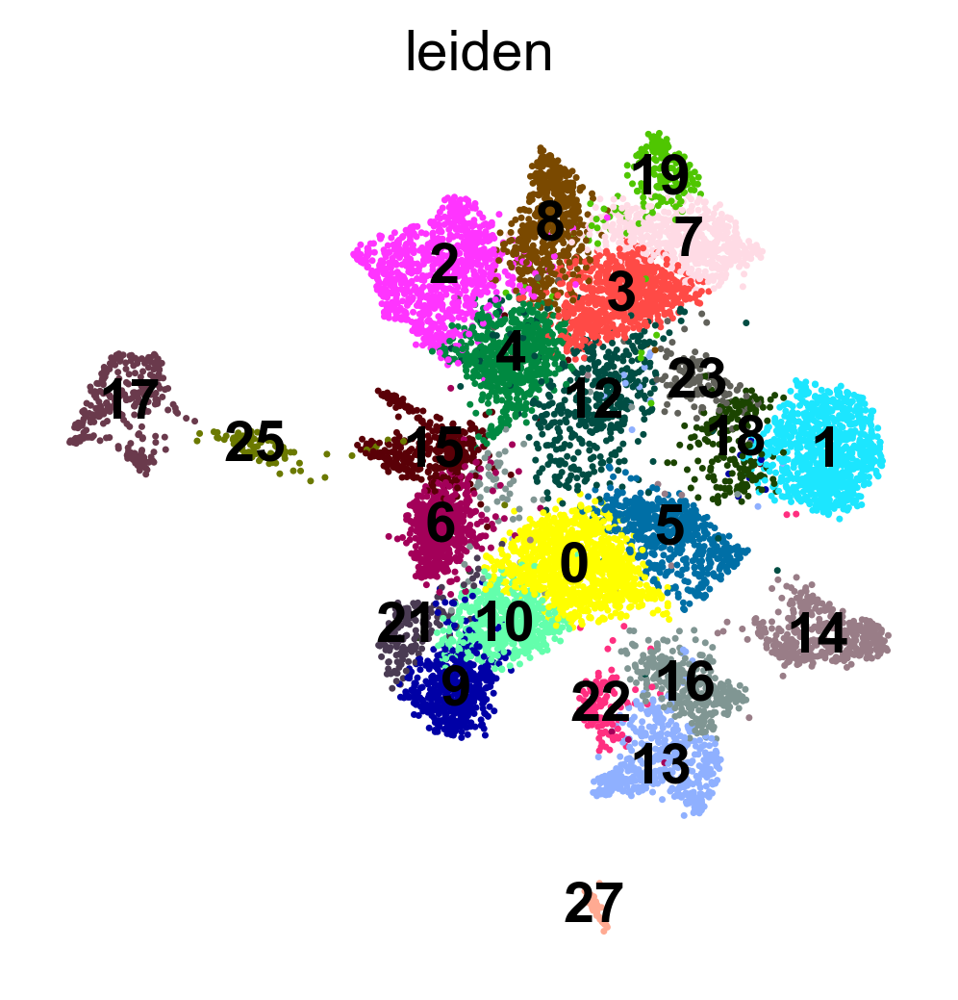

In [51]:
sc.pl.umap(adata1_sub, color=['leiden'],legend_loc="on data")

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\tools\_umap.py:165: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['umap'] = {'params': {'a': a, 'b': b}}
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


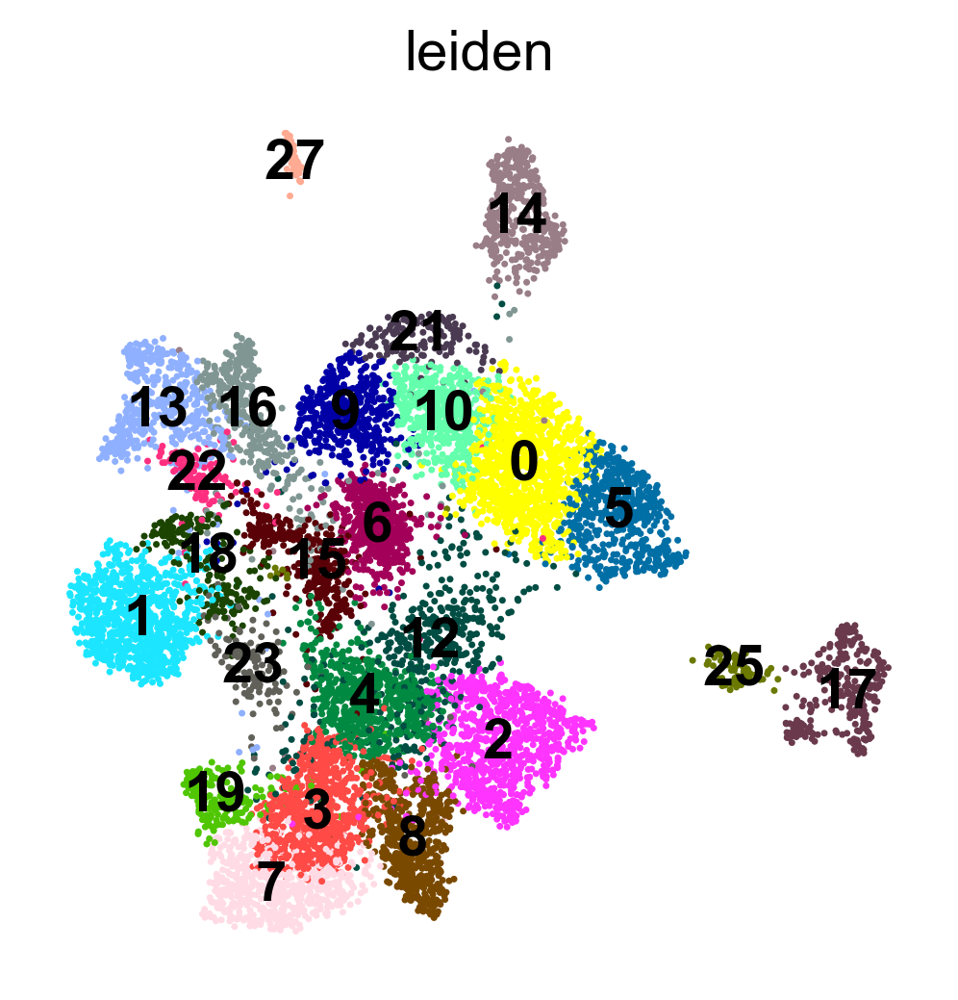

In [52]:
sc.tl.umap(adata1_sub)#,min_dist=0.6,alpha=0.5, gamma=0.5
sc.pl.umap(adata1_sub,color=["leiden"],legend_loc="on data")

In [53]:
adata1_sub.obs["cluster"]=adata1_sub.obs["leiden"]

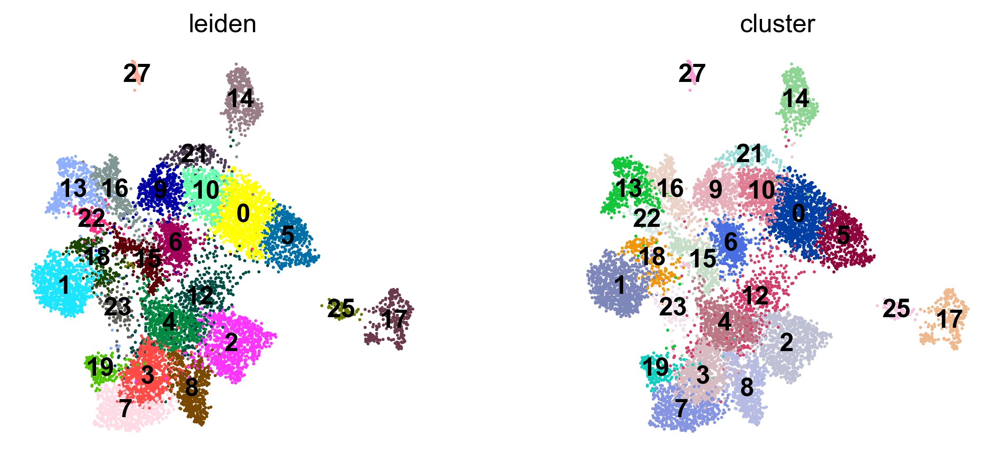

In [54]:
sc.pl.umap(adata1_sub,color=["leiden","cluster"],legend_loc="on data")

In [55]:
sc.pp.neighbors(adata1_sub, n_neighbors=50, n_pcs=50)
sc.tl.leiden(adata1_sub)

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


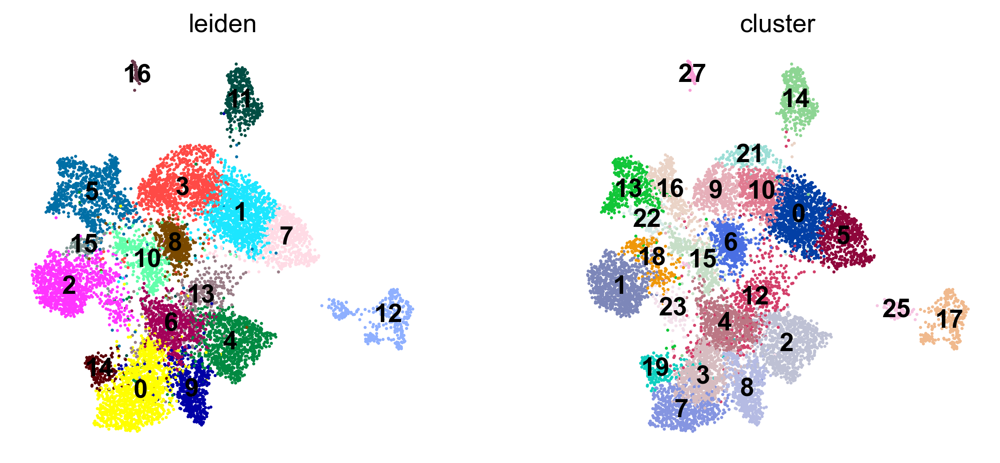

In [56]:
sc.pl.umap(adata1_sub,color=["leiden","cluster"],legend_loc="on data")

In [57]:
adata1_sub.layers["scaled"]=sc.pp.scale(adata1_sub.X,max_value=10,copy=True)
adata1_sub.obsm["X_pca"]=sc.pp.pca(adata1_sub[:,adata1_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata1_sub,n_neighbors=25,n_pcs=50,metric="cosine")
sc.tl.umap(adata1_sub)
sc.tl.leiden(adata1_sub,resolution=1.2,key_added='cluster2')

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


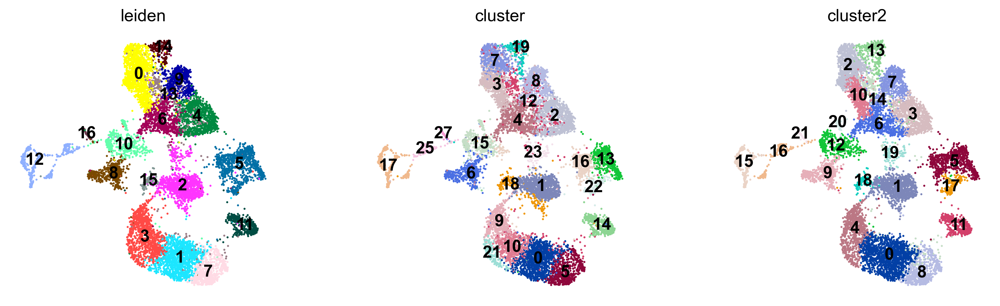

In [58]:
sc.pl.umap(adata1_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


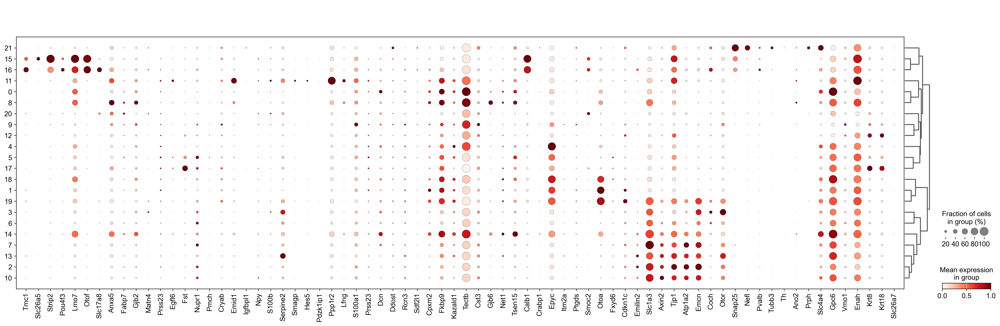

In [59]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(adata1_sub,groupby="leiden")
sc.pl.dotplot(adata1_sub, marker_genes, groupby="cluster2",dendrogram=True,standard_scale="var",
              save="neomycin_p3_neo_recluster.pdf");

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


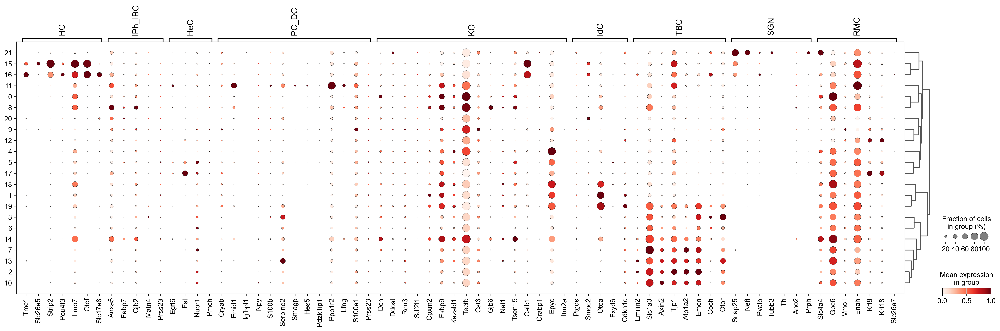

In [60]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata1_sub,
    groupby="cluster2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     save="cochlea-cell_type_p3_neo_dotplot2.pdf"
)

In [61]:
adata1_sub

AnnData object with n_obs × n_vars = 10680 × 3796
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scaled'
    obsp: 'distances', 'connectivities'

In [62]:
cluster_annotation = {
    '0': 'KO',
    '1': 'IdC',
    '2': 'TBC',
    '3': 'TBC',
    '4': 'KO',
    '5': 'HeC',
    '6': 'TBC',
    '7': 'TBC',
    '8': 'IPh_IBC',
    '9': 'RMC',
    '10': 'TBC',
    '11': 'PC_DC',
    '12': 'RMC',
    '13': 'TBC',
    '14': 'TBC',
    '15': 'HC',
    '16': 'HC',
    '17': 'HeC',
    '18': 'IdC',
    '19': 'IdC',
    '20': 'RMC',
    '21': 'SGN',
}
adata1_sub.obs['cell_type2'] = adata1_sub.obs['cluster2'].map(cluster_annotation).astype('category')

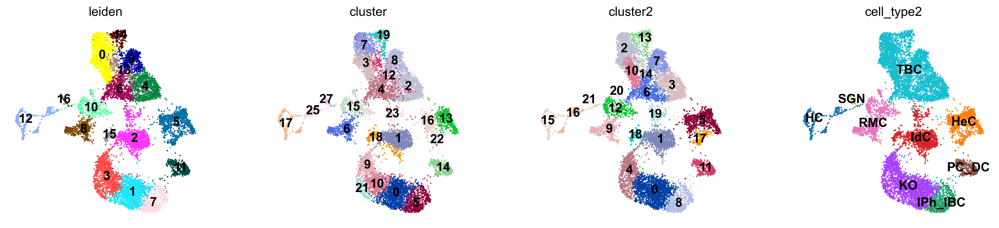

In [63]:
sc.pl.umap(adata1_sub,color=["leiden","cluster",'cluster2','cell_type2'],legend_loc="on data")

In [64]:
small_marker_dict={
     'HC' :["Tmc1","Slc26a5","Strip2","Pou4f3","Otof","Slc17a8"],
    'IPh_IBC':["Anxa5","Fabp7","Gjb2"],
    'HeC':["Fst","Nupr1"],
    'PC_DC':["Emid1","S100b","Ppp1r2"],
     'KO':["Dcn","Kazald1","Tectb","Epyc"],
    'IdC':["Otoa","Cdkn1c"],
     'TBC':["Axin2","Atp1a2","Emcn","Otor"],
    'SGN':["Snap25","Nefl","Tubb3"],
     'RMC':["Vmo1","Krt8","Krt18"],
}

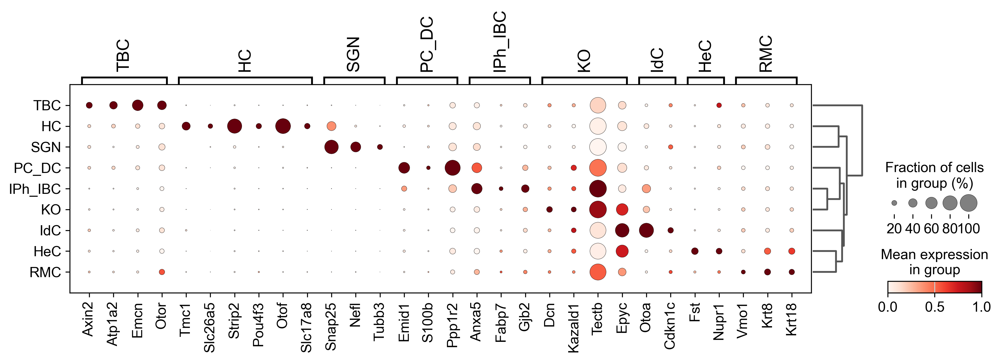

In [65]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata1_sub,
    groupby="cell_type2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     save="cochlea-cell_type_p3_neo_dotplot3.pdf"
)

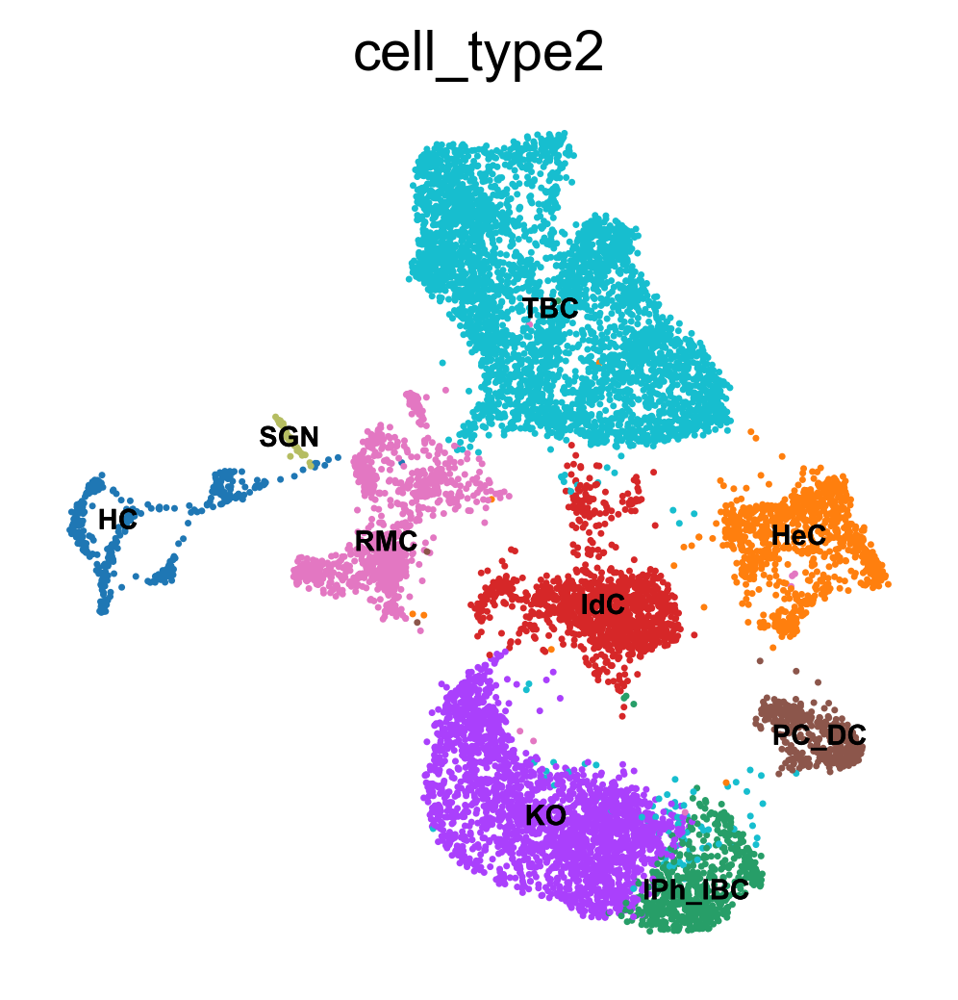

In [66]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata1_sub,color='cell_type2',legend_loc='on data',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="Neomycin_p3_neo_CELL_TYPE_ANNO.pdf")

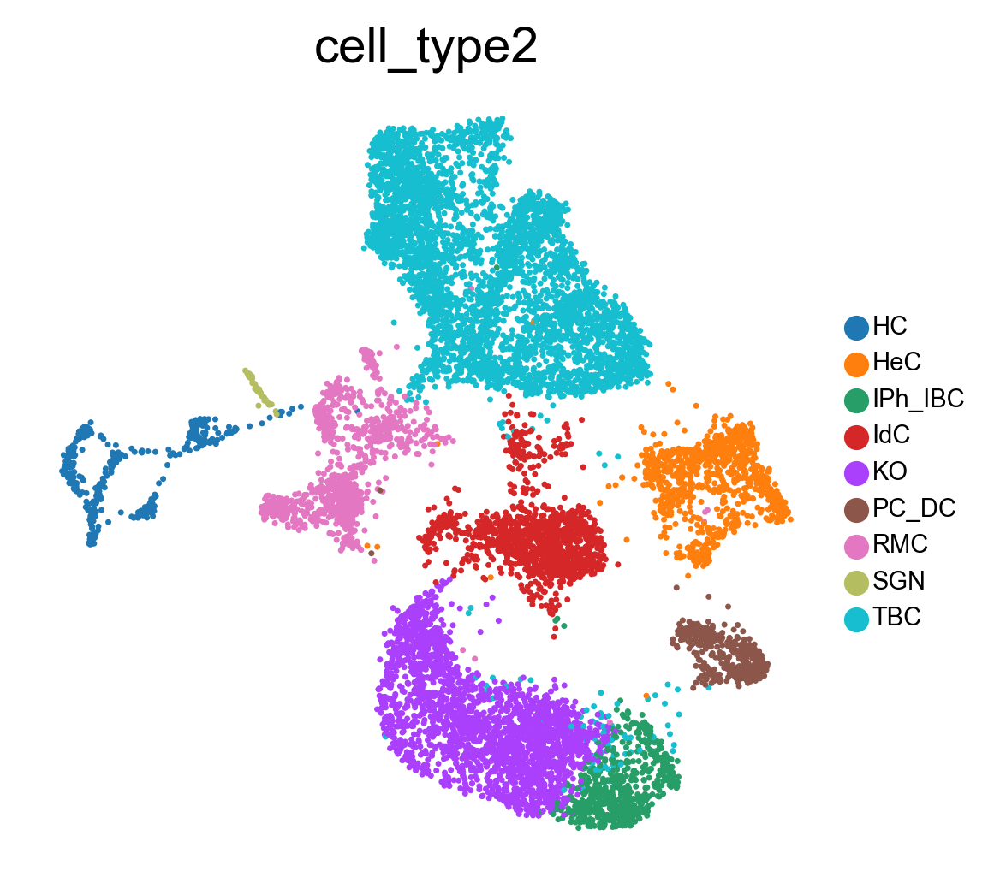

In [67]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata1_sub,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="Neomycin_p3_neo_CELL_TYPE_ANNO2.pdf")

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


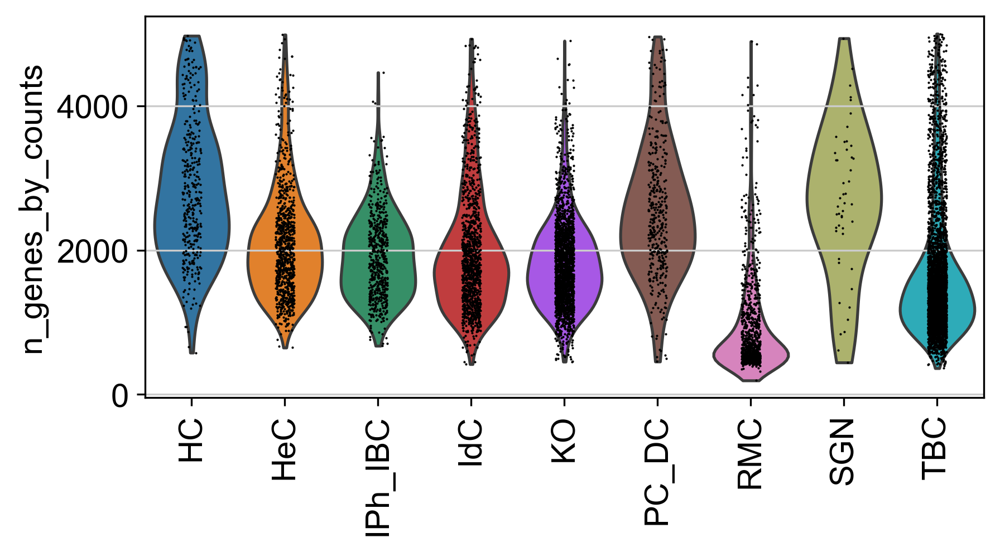

In [68]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(adata1_sub, ['n_genes_by_counts'], groupby='cell_type2',rotation=90)

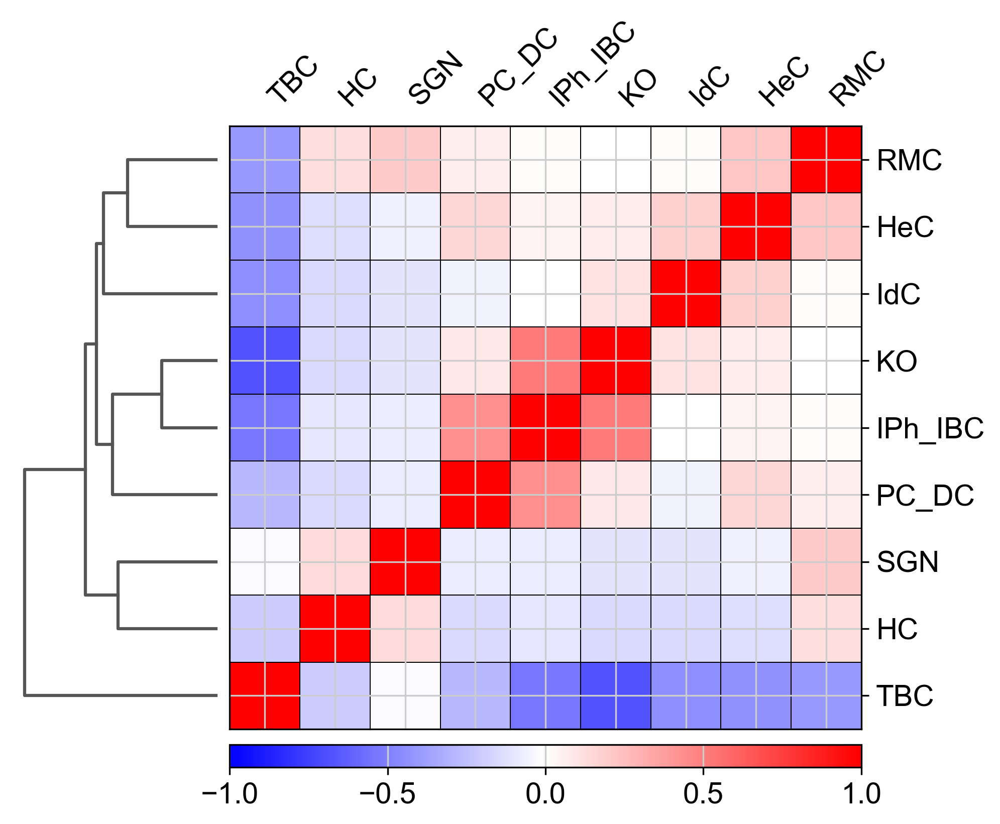

In [69]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.correlation_matrix(adata1_sub, 'cell_type2',
                         save="Neomycin_p3_neo_cell-type-correlation.pdf")

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


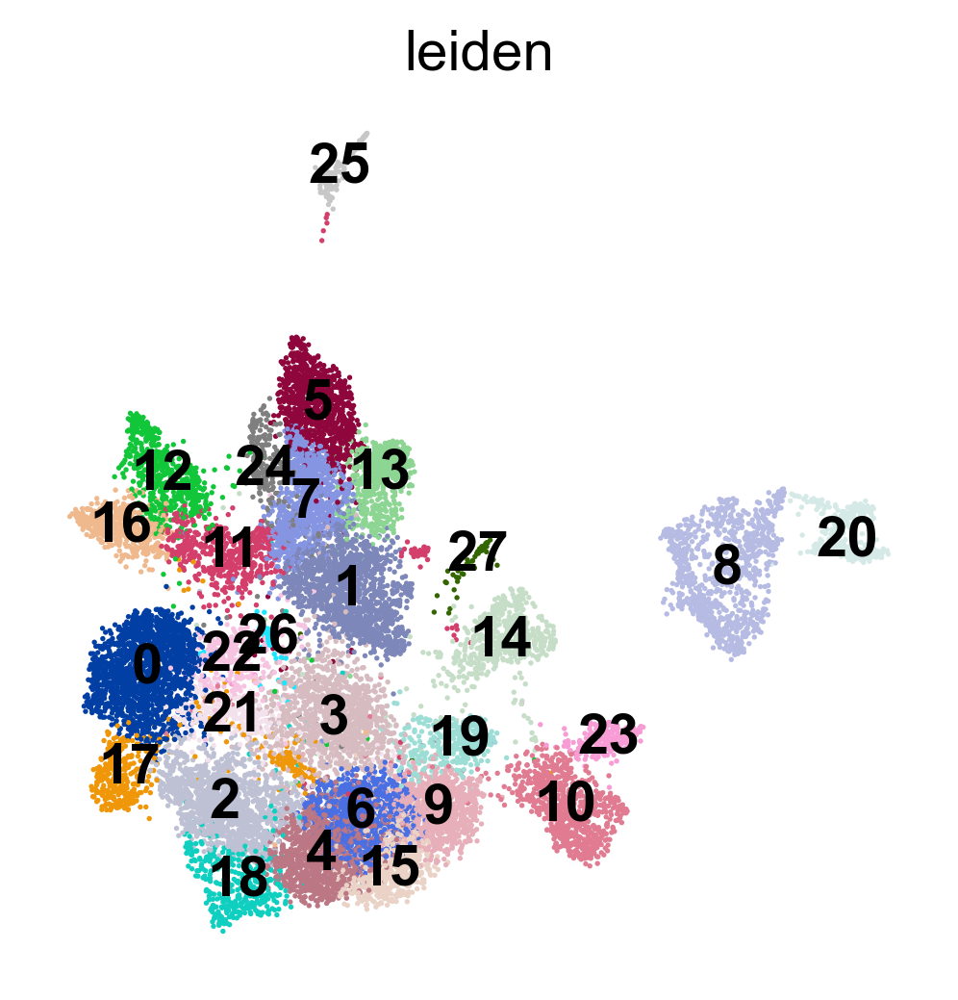

In [70]:
sc.pl.umap(adata2, color=['leiden'],legend_loc="on data")

In [71]:
small_marker_dict={
     'HC' :["Tmc1","Slc26a5","Strip2","Pou4f3","Otof","Slc17a8"],
    'IPh_IBC':["Anxa5","Fabp7","Gjb2"],
    'HeC':["Fst","Nupr1"],
    'PC_DC':["Emid1","S100b","Ppp1r2"],
     'KO':["Dcn","Kazald1","Tectb","Epyc"],
    'IdC':["Otoa","Cdkn1c"],
     'TBC':["Axin2","Atp1a2","Emcn","Otor"],
    'SGN':["Snap25","Nefl","Tubb3"],
     'RMC':["Vmo1","Krt8","Krt18"],
}

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


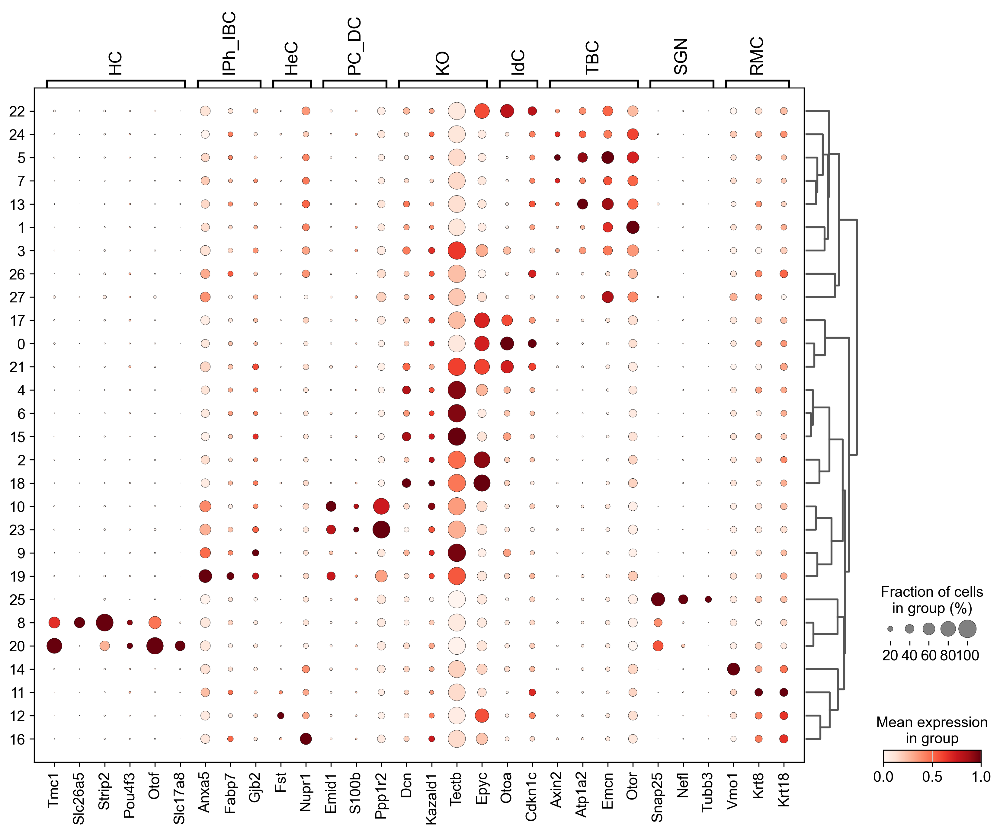

In [72]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2,
    groupby="leiden",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

In [73]:
small_marker_dict={
     'HC' :["Tmc1","Slc26a5","Strip2","Pou4f3","Lmo7","Otof","Slc17a8"],
    'IPh_IBC':["Anxa5","Fabp7","Gjb2","Matn4","Prss23"],
    'HeC':["Egfl6","Fst","Nupr1","Pmch"],
    'PC_DC':["Cryab","Emid1","Igfbpl1","Npy","S100b","Serpine2","Smagp","Hes5","Pdzk1ip1","Ppp1r2","Lfng","S100a1","Prss23"],
     'KO':["Dcn","Ddost","Rcn3","Sdf2l1",
      "Cpxm2","Fkbp9","Kazald1","Tectb",
      "Cst3","Gjb6","Net1","Tsen15",
      "Calb1","Crabp1","Epyc","Itm2a"],
'IdC':["Ptgds","Smoc2","Otoa","Fxyd6","Cdkn1c"],
     'TBC':["Emilin2","Slc1a3","Axin2","Tjp1","Atp1a2","Emcn","Coch","Otor"],
    'SGN':["Snap25","Nefl","Pvalb","Tubb3","Th","Ano2","Prph"],
     'RMC':["Slc4a4","Gpc6","Vmo1","Enah","Krt8","Krt18","Slc26a7"],
}

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


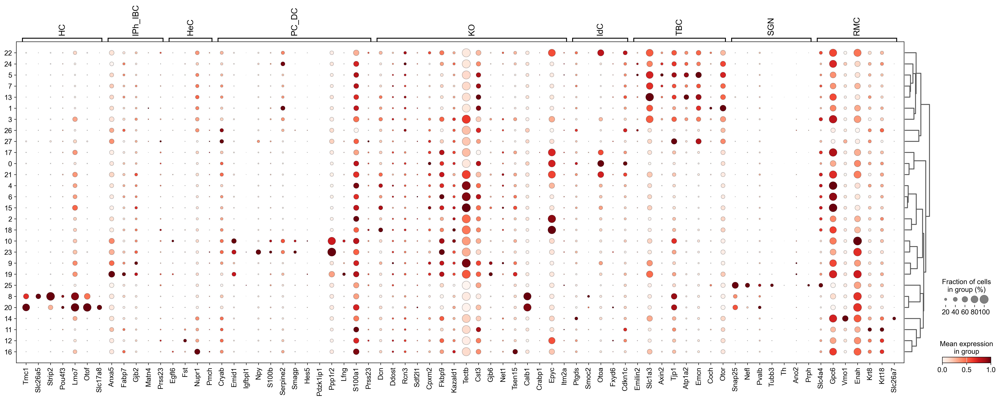

In [74]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2,
    groupby="leiden",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

In [75]:
#REMOVE 26 27
adata2_sub = adata2[adata2.obs['leiden'].isin(['0','1','2','3','4','5','6','7','8','9','10','11','12','13','14','15',
                                               '16','17','18','19','20','21','22','23','24','25'
    
])]

In [76]:
adata2_sub

View of AnnData object with n_obs × n_vars = 17869 × 2428
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

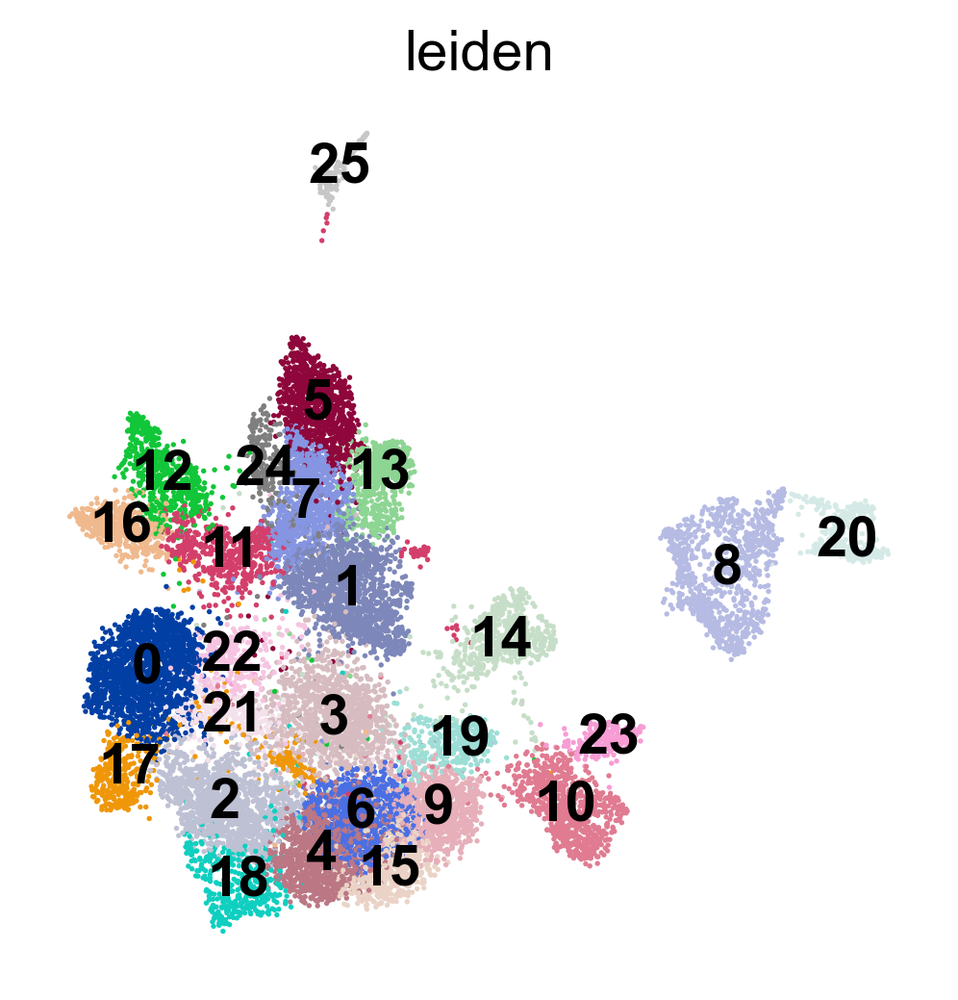

In [77]:
sc.pl.umap(adata2_sub, color=['leiden'],legend_loc="on data")

In [78]:
adata2_sub.obs["cluster"]=adata2_sub.obs["leiden"]

C:\Users\DELL\AppData\Local\Temp\ipykernel_17688\384029074.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2_sub.obs["cluster"]=adata2_sub.obs["leiden"]


In [79]:
adata2_sub.layers["scaled"]=sc.pp.scale(adata2_sub.X,max_value=10,copy=True)
adata2_sub.obsm["X_pca"]=sc.pp.pca(adata2_sub[:,adata2_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata2_sub,n_neighbors=30,n_pcs=50,metric="cosine")
sc.tl.umap(adata2_sub)
sc.tl.leiden(adata2_sub,resolution=1.4,key_added='cluster2')

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


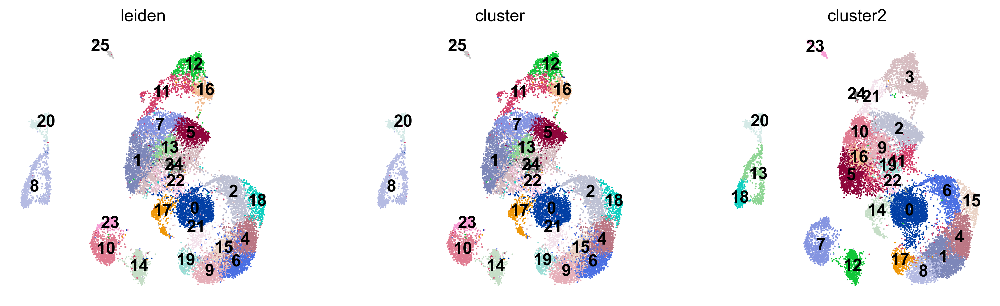

In [80]:
sc.pl.umap(adata2_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


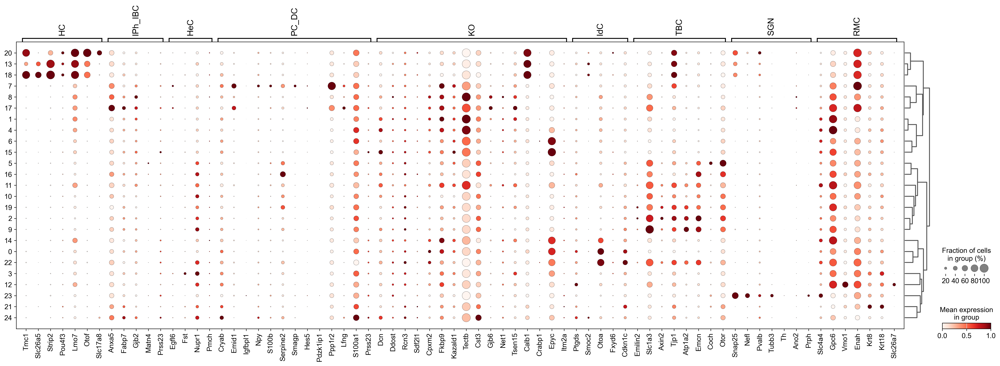

In [81]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2_sub,
    groupby="cluster2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

In [82]:
#remove11,16 24
adata2_sub = adata2_sub[adata2_sub.obs['cluster2'].isin(['0','1','2','3','4','5','6','7','8','9','10','12','13','14','15',
                                               '17','18','19','20','21','22','23'
    
])]

In [83]:
adata2_sub

View of AnnData object with n_obs × n_vars = 16687 × 2428
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scaled'
    obsp: 'distances', 'connectivities'

In [84]:
adata2_sub.layers["scaled"]=sc.pp.scale(adata2_sub.X,max_value=10,copy=True)
adata2_sub.obsm["X_pca"]=sc.pp.pca(adata2_sub[:,adata2_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata2_sub,n_neighbors=30,n_pcs=50,metric="cosine")
sc.tl.umap(adata2_sub)
sc.tl.leiden(adata2_sub,resolution=1.4,key_added='cluster2')

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


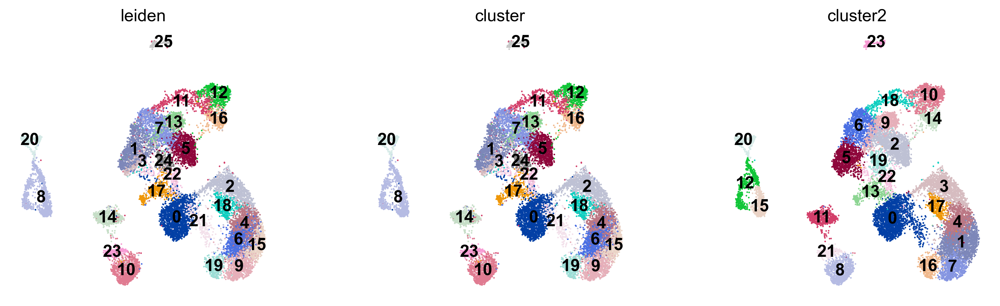

In [85]:
sc.pl.umap(adata2_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

In [86]:
sc.tl.dendrogram(adata2_sub,groupby="cluster2")

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


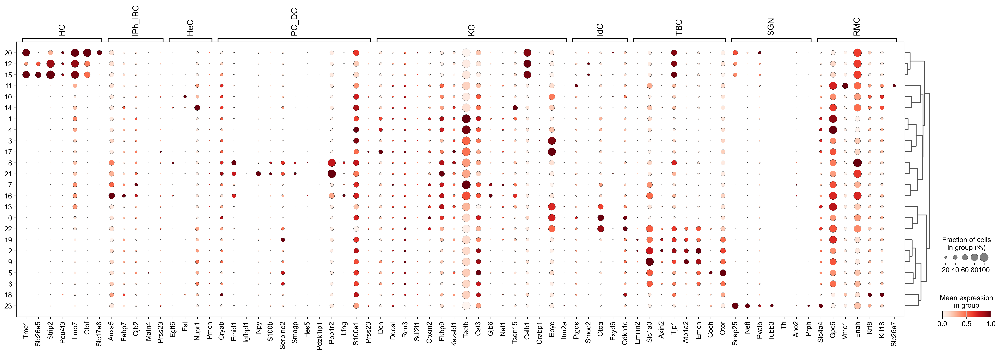

In [87]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2_sub,
    groupby="cluster2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

In [88]:
small_marker_dict={
     'HC' :["Tmc1","Slc26a5","Strip2","Pou4f3","Otof","Slc17a8"],
    'IPh_IBC':["Anxa5","Fabp7","Gjb2"],
    'HeC':["Fst","Nupr1"],
    'PC_DC':["Emid1","S100b","Ppp1r2"],
     'KO':["Dcn","Kazald1","Tectb","Epyc"],
    'IdC':["Otoa","Cdkn1c"],
     'TBC':["Axin2","Atp1a2","Emcn","Otor"],
    'SGN':["Snap25","Nefl","Tubb3"],
     'RMC':["Vmo1","Krt8","Krt18"]
}

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


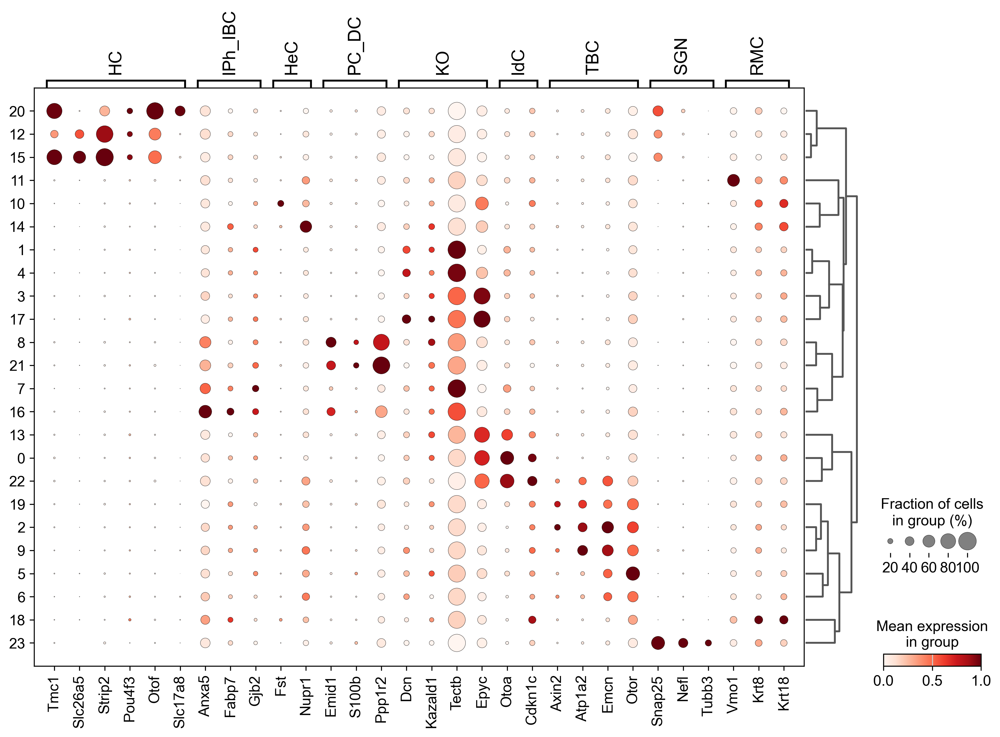

In [89]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2_sub,
    groupby="cluster2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

In [90]:
#remove 18
adata2_sub = adata2_sub[adata2_sub.obs['cluster2'].isin(['0','1','2','3','4','5','6','7','8','9','10','11','12','13','14','15',
                                               '16','17','19','20','21','22','23'
    
])]

In [91]:
adata2_sub

View of AnnData object with n_obs × n_vars = 16366 × 2428
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden', 'louvain', 'umap', 'leiden_colors', 'louvain_colors', 'dendrogram_leiden', 'cluster_colors', 'cluster2_colors', 'dendrogram_cluster2'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scaled'
    obsp: 'distances', 'connectivities'

In [92]:
adata2_sub.layers["scaled"]=sc.pp.scale(adata2_sub.X,max_value=10,copy=True)
adata2_sub.obsm["X_pca"]=sc.pp.pca(adata2_sub[:,adata2_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata2_sub,n_neighbors=30,n_pcs=50,metric="cosine")
sc.tl.umap(adata2_sub)
sc.tl.leiden(adata2_sub,resolution=1.4,key_added='cluster2')

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


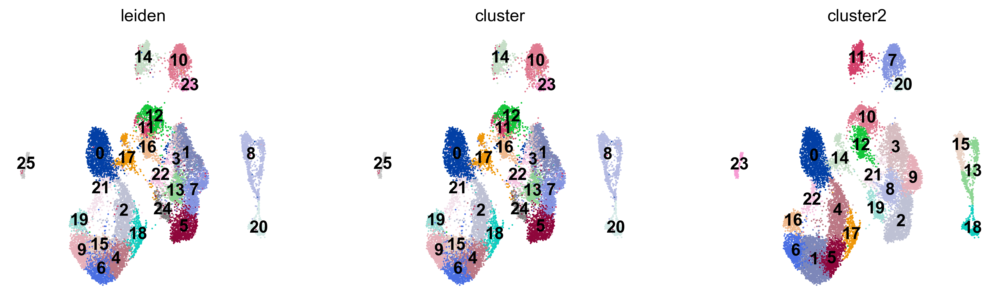

In [93]:
sc.pl.umap(adata2_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

In [94]:
sc.tl.dendrogram(adata2_sub,groupby="cluster2")

categories: 0, 1, 2, etc.
var_group_labels: HC, IPh_IBC, HeC, etc.


C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


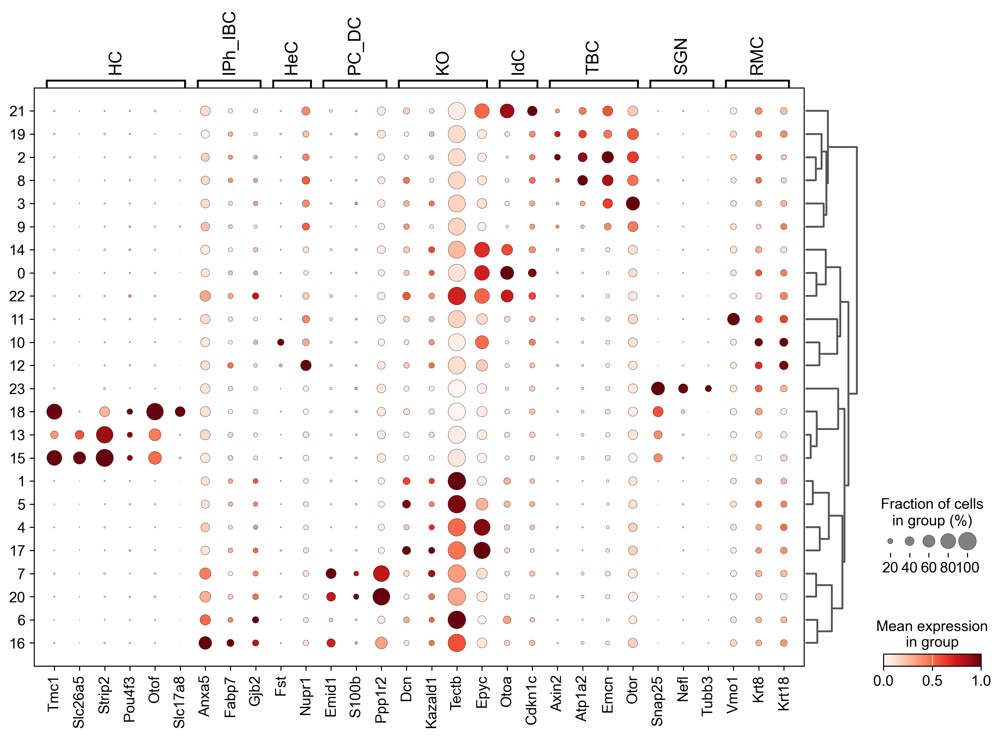

In [95]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2_sub,
    groupby="cluster2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     )

In [96]:
cluster_annotation = {
    '0': 'IdC',
    '1': 'KO',
    '2': 'TBC',
    '3': 'TBC',
    '4': 'KO',
    '5': 'KO',
    '6': 'IPh_IBC',
    '7': 'PC_DC',
    '8': 'TBC',
    '9': 'TBC',
    '10': 'HeC',
    '11': 'RMC',
    '12': 'HeC',
    '13': 'HC',
    '14': 'IdC',
    '15': 'HC',
    '16': 'IPh_IBC',
    '17': 'KO',
    '18': 'HC',
    '19': 'TBC',
    '20': 'PC_DC',
    '21': 'TBC',
    '22': 'IdC',
    '23': 'SGN',

}
adata2_sub.obs['cell_type2'] = adata2_sub.obs['cluster2'].map(cluster_annotation).astype('category')

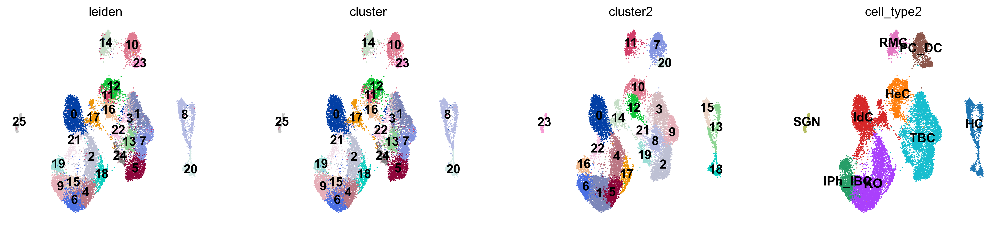

In [97]:
sc.pl.umap(adata2_sub,color=["leiden","cluster",'cluster2','cell_type2'],legend_loc="on data")

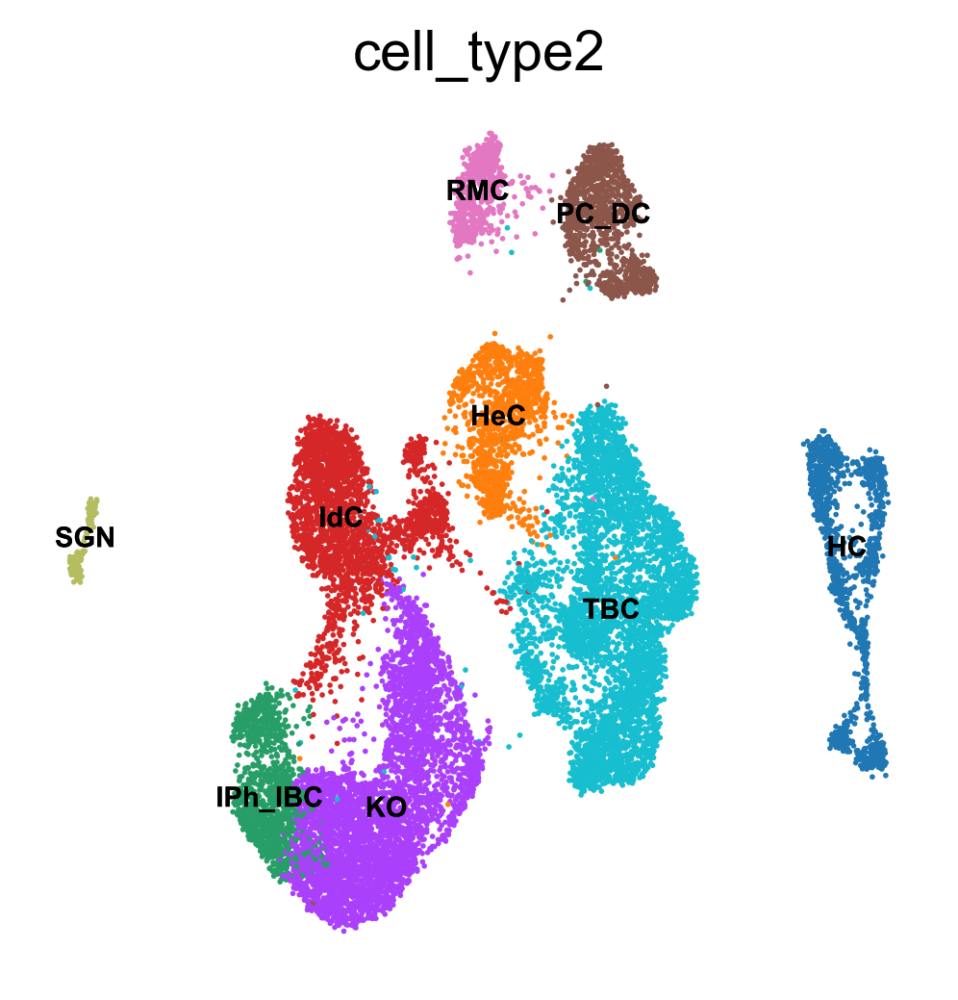

In [98]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata2_sub,color='cell_type2',legend_loc='on data',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="Neomycin_p3_ctr_CELL_TYPE_ANNO1.pdf")

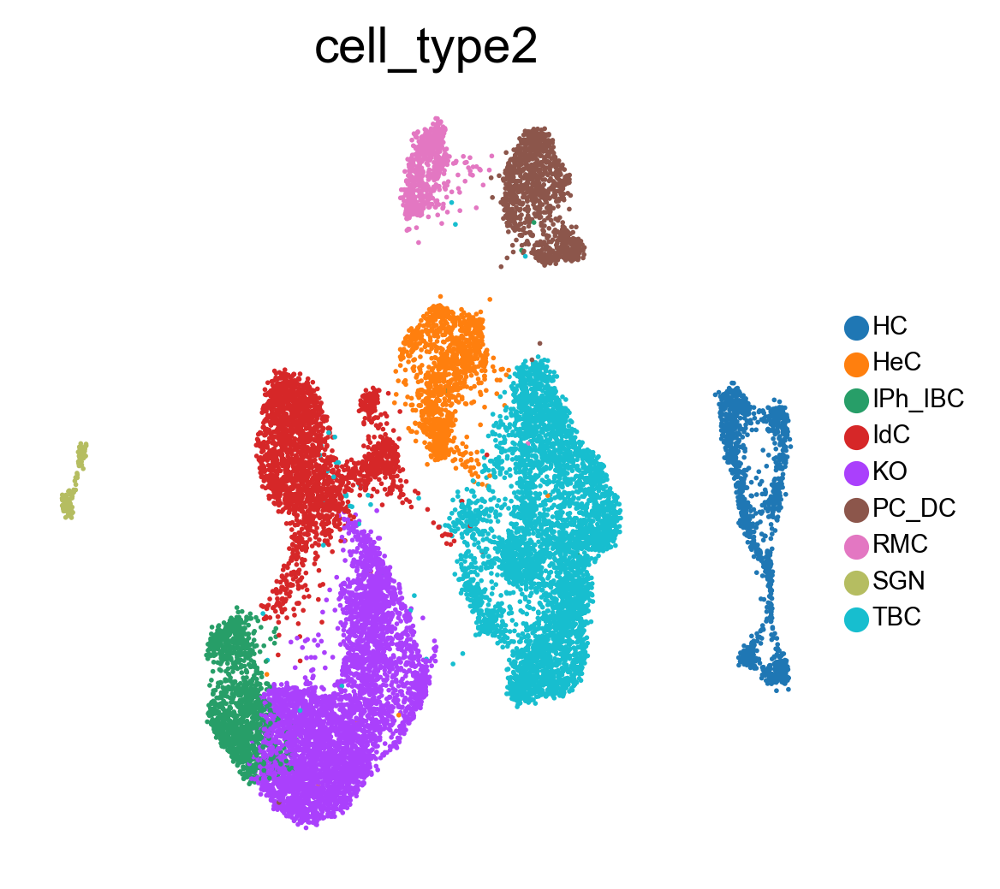

In [99]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata2_sub,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="Neomycin_p3_ctr_CELL_TYPE_ANNO2.pdf")

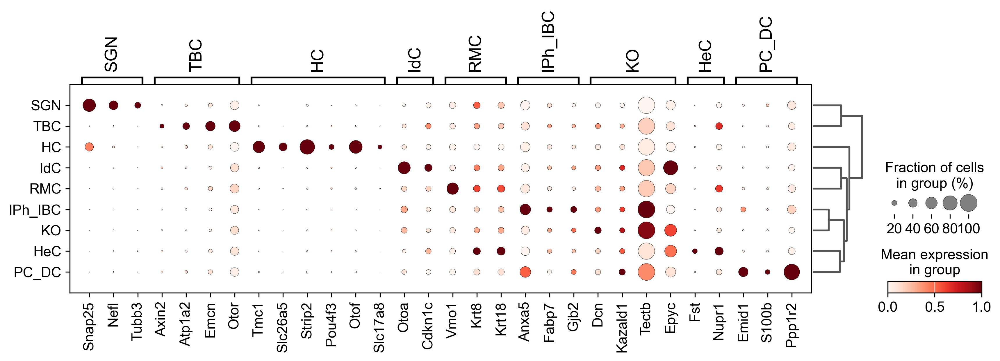

In [100]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    adata2_sub,
    groupby="cell_type2",
    var_names=small_marker_dict,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
     save="cochlea-cell_type_p3_ctr_dotplot3.pdf"
)

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


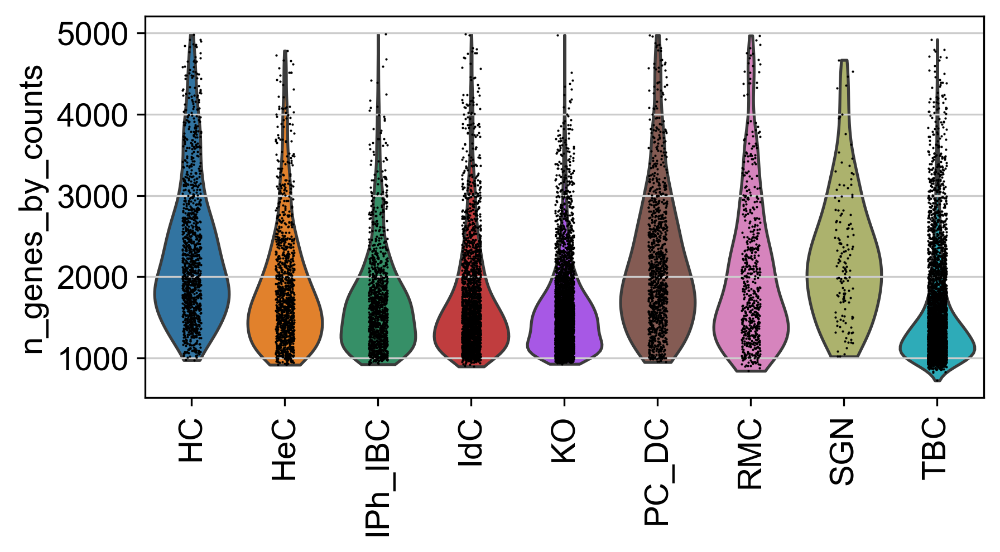

In [101]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(adata2_sub, ['n_genes_by_counts'], groupby='cell_type2',rotation=90)

In [102]:
adata1_sub.write("P3_NEO_SCANPY_sub.h5ad")

In [103]:
adata2_sub.write("P3_CTR_SCANPY_sub.h5ad")

In [104]:
cd D:\chai_WJH\Neomycin_Project\R

D:\chai_WJH\Neomycin_Project\R


In [105]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import sys
import scipy
import anndata
adata1_sub = sc.read( 'P3_NEO_SCANPY_sub.h5ad')

In [106]:
adata2_sub = sc.read( 'P3_CTR_SCANPY_sub.h5ad')

In [107]:
adata1_sub

AnnData object with n_obs × n_vars = 10680 × 3796
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2', 'cell_type2'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cell_type2_colors', 'cluster2_colors', 'cluster_colors', 'dendrogram_cell_type2', 'dendrogram_cluster2', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scaled'
    obsp: 'connectivities', 'distances'

In [108]:
adata2_sub

AnnData object with n_obs × n_vars = 16366 × 2428
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2', 'cell_type2'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cell_type2_colors', 'cluster2_colors', 'cluster_colors', 'dendrogram_cell_type2', 'dendrogram_cluster2', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scaled'
    obsp: 'connectivities', 'distances'

In [109]:
adata1_raw=adata1_sub.raw.to_adata()
adata1_raw

AnnData object with n_obs × n_vars = 10680 × 33696
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2', 'cell_type2'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'cell_type2_colors', 'cluster2_colors', 'cluster_colors', 'dendrogram_cell_type2', 'dendrogram_cluster2', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [110]:
adata2_raw=adata2_sub.raw.to_adata()
adata2_raw

AnnData object with n_obs × n_vars = 16366 × 33696
    obs: 'CellID', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain', 'cluster', 'cluster2', 'cell_type2'
    var: 'gene_ids', 'feature_types', 'Gene', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'cell_type2_colors', 'cluster2_colors', 'cluster_colors', 'dendrogram_cell_type2', 'dendrogram_cluster2', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


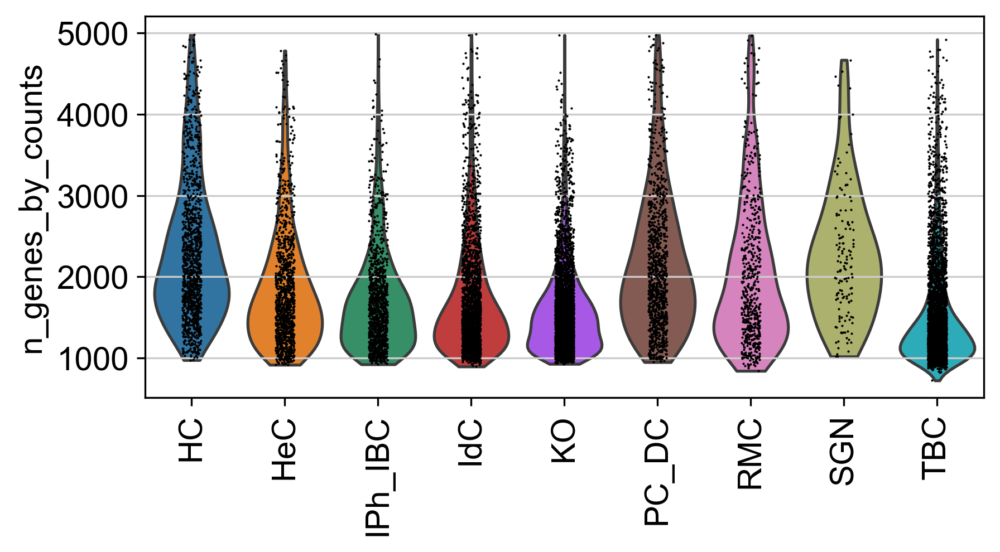

In [111]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(adata2_raw, ['n_genes_by_counts'], groupby='cell_type2',rotation=90)

In [112]:
adata1_raw.write("P3_NEO_SCANPY_raw.h5ad")

In [113]:
adata2_raw.write("P3_CTR_SCANPY_raw.h5ad")

C:\Users\DELL\.conda\envs\python38\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


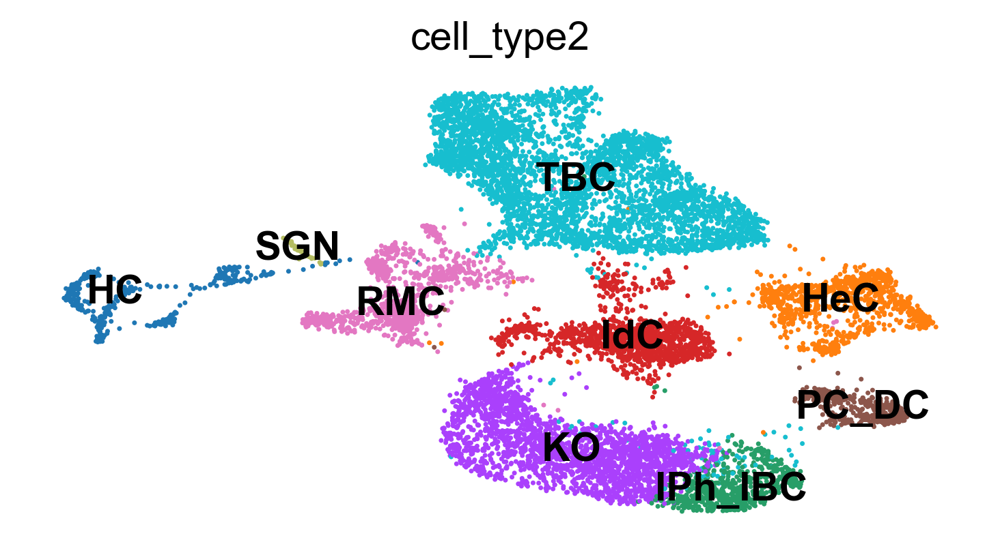

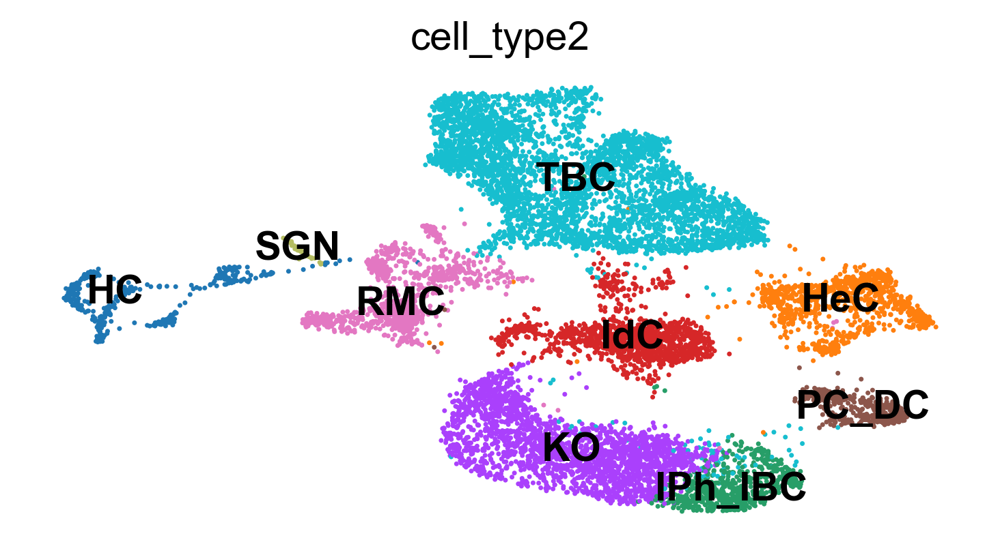

In [114]:
sc.pl.umap(adata1_sub, color=['cell_type2'],legend_loc="on data")
sc.pl.umap(adata1_raw, color=['cell_type2'],legend_loc="on data")